## Импортируем библиотеки

In [64]:
pip install opencv-contrib-python --user


  Using cached opencv_contrib_python-4.10.0.82-cp37-abi3-win_amd64.whl.metadata (20 kB)
Using cached opencv_contrib_python-4.10.0.82-cp37-abi3-win_amd64.whl (45.5 MB)
Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import os
import cv2
import numpy as np
from PIL import Image, ImageEnhance, ImageEnhance, ImageGrab, ImageOps, ImageFilter
import matplotlib.pyplot as plt
import tifffile
from dataclasses import dataclass
from sklearn.neighbors import NearestNeighbors
from skimage.transform import rescale

## Загружаем файлы  
`bases` - список с `base`подложками  
`crops` - списко с `crop` изображениями, которые нужно будет найти

In [2]:
base_path = 'C:/Users/Maria Smirnova/Desktop/Проекты/LDT/scenes'
base_key_word = 'layout'
files_format = ['tif']

crops = [] 
bases = []
for address, dirs, files in os.walk(base_path):
    #print(address, dirs, files)
    for f in files:
            if f.endswith('tif'):
                file_path = os.path.join(address, f)
                if (base_key_word in f):
                    if f  == 'layout_2021-08-16.tif':
                        #masks.append(Image.open(file_path))
                        base = tifffile.imread(file_path)
                        bases.append(base)
                else:
                    #images.append(Image.open(file_path))
                    #images.append(Scene(tifffile.imread(file_path), 0))
                    crops.append(tifffile.imread(file_path))

print('Количество изображений:', len(crops), '\nКоличество подложек:', len(bases))

Количество изображений: 20 
Количество подложек: 1


## Функции просмотра изображений

### Функции просмотра и нормализации

In [3]:
def row_img_to_layers(img):
    norm_coef = 90
    r = normalize_channel(img[:,:,0], norm_coef)
    g = normalize_channel(img[:,:,1], norm_coef)
    b = normalize_channel(img[:,:,2], norm_coef)
    nir = normalize_channel(img[:,:,3], norm_coef)
    return r, g, b, nir

def hist_equalization(channel:np.array) -> np.array:
    if len(channel.shape) > 2:
        print(channel.shape[len(channel.shape)-1])
        channel = cv2.cvtColor(channel, cv2.COLOR_BGR2GRAY)
    channel = cv2.equalizeHist(channel)
    return channel

def normalize_channel(channel: np.array, perc_thr: int = 100, lower_pecr_thr: int = 2) -> np.array:
    '''
    Get's (h, w, 1) - channel-layer, pecentage to cut histogram
    return normalize and cut data
    '''
    perc_rows = np.percentile(channel, perc_thr, axis=1)
    perc_cols = np.percentile(channel, perc_thr, axis=0)
    thr = max(np.max(perc_rows), np.max(perc_cols))

    lower_pecr_thr = 2
    perc_rows = np.percentile(channel, lower_pecr_thr, axis=1)
    perc_cols = np.percentile(channel, lower_pecr_thr, axis=0)
    thr_min = min(np.min(perc_rows), np.min(perc_cols))

    channel[channel > thr] = thr
    #l[l > thr] = np.mean(l)
    channel[channel < thr_min] = thr_min
    if np.max(channel) !=0:
        channel = channel/np.max(channel)
    channel = channel*255 # приводим к 0 255
    channel = channel.astype(np.uint8)
    return channel

def normalize(image: np.array, perc_thr: int = 100, lower_pecr_thr: int = 2) -> np.array:
    '''
    Get's (h, w, 1) - image, pecentage to cut histogram
    return normalize image
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0], perc_thr, lower_pecr_thr)
    g = normalize_channel(image[:, :, 1], perc_thr, lower_pecr_thr)
    b = normalize_channel(image[:, :, 2], perc_thr, lower_pecr_thr)
    nir = normalize_channel(image[:, :, 3], perc_thr, lower_pecr_thr)
    if channel == 0:
        r = normalize_channel(image[0, :, :], perc_thr, lower_pecr_thr)
        g = normalize_channel(image[1 :, :], perc_thr, lower_pecr_thr)
        b = normalize_channel(image[2, :, :], perc_thr, lower_pecr_thr)
        nir = normalize_channel(image[3, :, :], perc_thr, lower_pecr_thr)
    image = np.dstack((r, g, b, nir))
    return image

def imshow(image: np.array, bands: str, hist_equal: bool = False):
    '''
    Function get images as np.array 
    and bands neeeded to show (1 to 3), expl: r, nir, d
    and print it
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0])
    g = normalize_channel(image[:, :, 1])
    b = normalize_channel(image[:, :, 2])
    nir = normalize_channel(image[:, :, 3])
    if channel == 0:
        r = normalize_channel(image[0, :, :])
        g = normalize_channel(image[1 :, :])
        b = normalize_channel(image[2, :, :])
        nir = normalize_channel(image[3, :, :])
            
    chn_dict = {'r':r, 'g':g, 'b':b, 'nir':nir}

    if hist_equal:
        for key in list(chn_dict.keys()):
            chn_dict[key] = hist_equalization(chn_dict[key])

    b_list = []
    for b in bands.split(', '):
        b_list.append(chn_dict[b])
    
    img = np.dstack(b_list)
    plt.imshow(img)
    plt.show()

def normalized_filtered(image: np.array, bands: str, hist_equal: bool = False):
    '''
    The same as imshow(), but return np.array
    '''
    channel = np.nan
    for i in range(len(image.shape)):
        if image.shape[i] == len(image.shape):
            channel == i
    r = normalize_channel(image[:, :, 0])
    g = normalize_channel(image[:, :, 1])
    b = normalize_channel(image[:, :, 2])
    nir = normalize_channel(image[:, :, 3])
    if channel == 0:
        r = normalize_channel(image[0, :, :])
        g = normalize_channel(image[1 :, :])
        b = normalize_channel(image[2, :, :])
        nir = normalize_channel(image[3, :, :])
            
    chn_dict = {'r':r, 'g':g, 'b':b, 'nir':nir}

    if hist_equal:
        for key in list(chn_dict.keys()):
            chn_dict[key] = hist_equalization(chn_dict[key])

    b_list = []
    for b in bands.split(', '):
        b_list.append(chn_dict[b])
    
    img = np.dstack(b_list)
    return img


### Функции расчёта индексов и масок

In [4]:
# показывает растительность
def calcus_NDVI(r:np.array, nir:np.array, masking:bool = False) -> np.array:
    NDVI = (nir - r)/(nir +r)
    NDVI[NDVI>1] = 1
    NDVI[NDVI<-1] = -1
    if masking:
        NDVI = np.nan_to_num(NDVI)
        NDVI[NDVI>=0.7] = 4
        NDVI[(NDVI>=0.4)&(NDVI<0.7)] = 3
        NDVI[(NDVI>=0)&(NDVI<0.4)] = 2
        NDVI[(NDVI>=-1)&(NDVI<0)] = 1
    return NDVI

# оптимизированный NDVI, учитывает атмосферные воздыейтсви и фоновый сигнал раст., не становится оч насыщенным
def calcus_EVI(r, b, nir, masking:bool = False):
    EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
    EVI[EVI>10] = 10
    EVI[EVI<-5] = -5
    if masking:
        EVI[EVI<-2.1] = -100
        EVI[(EVI>=-2.1)&(EVI<0)] = -200 
        EVI[(EVI>=0)&(EVI<8)] = -300
        EVI[EVI>=8] = -400
        EVI = EVI/(-100) 
    return EVI

# индекс фотосинтетической активности растительного покрова
def calcus_GNDVI(g, nir, masking=False):
    GNDVI = (nir-g)/(nir+g)
    GNDVI[GNDVI>1] = 1
    GNDVI[GNDVI<-1] = -1
    if masking:
        GNDVI = np.nan_to_num(GNDVI)
        GNDVI[GNDVI<0.2] = 100
        GNDVI[(GNDVI>=0.2) & (GNDVI<0.57)] = 200
        GNDVI[(GNDVI>=0.57) & (GNDVI<0.8)] = 300
        GNDVI[(GNDVI>=0.8)& (GNDVI<=1)] = 400
        GNDVI = GNDVI/100
    return GNDVI

# концентрация хлорофила, оч. зависит от времени года
# лучше не использовать
def calcus_MCARI(r,g,nir):
    MCARI = (1.5*(2.5*(nir - r) - 1.3*(nir - g)))/np.sqrt((2*nir + 1)**2 - (6*nir - 5*np.sqrt(r))) - 5
    MCARI[MCARI>10] = np.nan
    MCARI[MCARI<-4] = np.nan
    return MCARI

# индекс мутности воды, слабо резает
def calcus_NDTI(r,g, masking=False):
    NDTI = (r-g)/(r+g)
    if masking:
        NDTI[NDTI<60] = 1
        NDTI[(NDTI>=60)&(NDTI<80)] = 2
        NDTI[NDTI>=80] = 3
    return NDTI

#ration vegetation index 
def calcus_RVI(r, nir, masking=False):
    if r.any() == 0:
        r = 1
    RVI = nir/r
    if masking:
        RVI = np.nan_to_num(RVI)
        #RVI[RVI<2.5] = 1
        #RVI[(RVI>=2.5)&(RVI<4.0)] = 2
        #RVI[(RVI>4.0)&(RVI<10)] = 3
        #RVI[RVI>=10] = 4
        RVI[(RVI<1.5)] = 1
        RVI[(RVI>=1.5)&(RVI<3)] = 2
        RVI[RVI>=3] = 3
    return RVI

# Kauth-Thomas transformation Tasseled Cap
# Используем ИК без разделения, в оригнале ИК делится по волнам: 07,-08/ 0,8-1,1
def calcus_tasseled_cap(r,g, nir, masking=False):
    # яркость, связана с измненеиями в почве
    b = 0.433*g + 0.632*r + 0.586*nir + 0.264*nir +32
    # зелёность, связана с зелёной растительность, похожа на вегетационный индекс
    g = -0.290*g-0.562*r+0.600*nir+0.491*nir +32
    # желтость, старением растений
    y = -0.829*g +0.522*r-0.039*nir +0.197*nir +32
    # nonesuch
    n = 0.233*g+0.012*r-0.543*nir +0.810*nir +32
    tass_cap = np.dstack((b, g, y, n))
    if masking:
        tass_cap[tass_cap<-2000] = -10000
        tass_cap[(tass_cap>=-2000)&(tass_cap<0)] = -20000
        tass_cap[(tass_cap>=0)&(tass_cap<1800)] = -30000
        tass_cap[(tass_cap>=1800)&(tass_cap<3700)] = -40000
        tass_cap[tass_cap>=3500] = -50000
        tass_cap = tass_cap/(-10000)
    return tass_cap



#normalized diffference snow index
# НЕ ИСПОЛЬЗУЕМ 
#вместо коротковолнового ИК, просто ИК
def calcus_NDSI(g, nir):
    NDSI = (g-nir)/(g+nir)
    return NDSI

#normalized defference water index
def calcus_NDWI(g, nir, masking=False):
    NDWI = (g-nir)/(g+nir)
    if masking:
        NDWI[NDWI<26] = 1
        NDWI[(NDWI>=26)&(NDWI<42)] = 2
        NDWI[(NDWI>=42)] = 3
    return NDWI


def count_class_masked(mask: np.array, class_amount: int):
    unique_values, counts = np.unique(mask, return_counts=True)
    data = dict(zip(unique_values, counts))
    sum = mask.shape[0]*mask.shape[1]
    result = []
    for i in range(1, class_amount):
        if i not in data:
            result.append(0)
        else:
            result.append(data[i]/sum)
    return result

### Функции работы с битыми пикселями

In [5]:
def get_mean_neighbours(image, channel: int, x: int, y: int) -> int:
        neighbours = []
        rows, cols = image.shape[:-1]

        # Список смещений для всех возможных соседей
        offsets = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
        for dy, dx in offsets:
            ny, nx = y + dy, x + dx
            if 0 <= nx < cols and 0 <= ny < rows:
                neighbours.append(image[ny][nx][channel])
        return round(np.mean(neighbours))

def calculate_thresholds(image):
    # Преобразование изображения в одномерный массив
    flattened_image = image.flatten()

    median_value = np.median(flattened_image)
    # Вычисление пороговых значений
    low_threshold = 0.15 * median_value
    high_threshold = 5.0 * median_value

    return low_threshold, high_threshold    

def fix(image):
    raster = image.copy()
    y, x = image.shape[:-1]
    for channel in range(image.shape[-1]):
        min_pixel, max_pixel = calculate_thresholds(raster[:, :,channel])
        # print(f'low is {min_pixel}, max is {max_pixel}')
        for i in range(y):
            for j in range(x):
                if raster[i][j][channel] < min_pixel or raster[i][j][channel] > max_pixel:
                    new_pixel = get_mean_neighbours(raster, channel, y=i, x=j)
                    #  task:    [номер строки]; [номер столбца]; [номер канала]; [«битое» значение]; [исправленное значение]
                    #print(f"[{i}];[{j}];[{channel + 1}];[{raster[i][j][channel]}];[{new_pixel}]")
                    raster[i][j][channel] = new_pixel
    return raster

### Описываем класс `Scene`

In [6]:
@dataclass
class Scene:
    row_img: np.array
    img: np.array
    is_mask: bool
    r: np.array
    g: np.array
    b: np.array
    nir: np.array
    NDVI: np.array
    NDVI_mask: np.array
    NDVI_list: list
    EVI:np.array
    EVI_mask: np.array
    EVI_list: list
    GNDVI:np.array
    GNDVI_mask: np.array
    GNDVI_list: list
    #MCARI:np.array
    NDTI: np.array
    NDTI_mask: np.array
    NDTI_list: list
    RVI: np.array
    RVI_mask: np.array
    RVI_list: list
    tass_cap: np.array
    tass_cap_mask: np.array
    tass_cap_list: np.array
    NDWI: np.array
    NDWI_mask: np.array
    NDWI_list: list
    mask_list: list
    #all_layes: np.array

    def __init__(self, row_img: np.array, is_mask: bool):
        self.row_img = row_img
        self.img = row_img
        self.is_mask = is_mask
        self.r ,self.g, self.b, self.nir = row_img_to_layers(row_img)
        self.NDVI = calcus_NDVI(self.r,self.nir)
        self.NDVI_mask = calcus_NDVI(self.r,self.nir, True)
        self.NDVI_list = count_class_masked(self.NDVI_mask, 4)
        self.EVI = calcus_EVI(self.r, self.b, self.nir)
        self.EVI_mask = calcus_EVI(self.r, self.b, self.nir, True)
        self.EVI_list = count_class_masked(self.EVI_mask, 4)
        self.GNDVI = calcus_GNDVI(self.g, self.nir)
        self.GNDVI_mask = calcus_GNDVI(self.g, self.nir, True)
        self.GNDVI_list = count_class_masked(self.GNDVI_mask, 3)
        #self.MCARI = calcus_MCARI(self.r, self.g, self.nir)
        self.NDTI = calcus_NDTI(self.r, self.g)
        self.NDTI_mask = calcus_NDTI(self.r, self.g, True)
        self.NDTI_list = count_class_masked(self.NDTI_mask, 3)
        self.RVI = calcus_RVI(self.r, self.nir)
        self.RVI_mask = calcus_RVI(self.r, self.nir, True)
        self.RVI_list = count_class_masked(self.RVI_mask, 4)
        self.tass_cap = calcus_tasseled_cap(self.r, self.g, self.nir)
        self.tass_cap_mask = calcus_tasseled_cap(self.r, self.g, self.nir, True)
        self.tass_cap_list = count_class_masked(self.tass_cap_mask, 5)
        self.NDWI = calcus_NDWI(self.g, self.nir)
        self.NDWI_mask = calcus_NDWI(self.g, self.nir, True)
        self.NDWI_list = count_class_masked(self.NDWI_mask, 3)
        self.mask_list = [self.NDVI_list, self.EVI_list, self.GNDVI_list, self.RVI_list, self.tass_cap_list, self.NDWI_list ]
        
        '''
        self.all_layers = np.dstack((self.r, self.g, self.b, self.nir,
                                    self.NDVI, self.EVI, self.GNDVI,
                                    self.NDTI, self.RVI, self.tass_cap,
                                    self.NDWI))
        '''

## Создаём объекты класса для `crops`  
Объекты классов записываются в `crop_scenes`

In [7]:
crop_scenes = []
for c in crops:
    crop_scenes.append(Scene(c, 0))

print(f'Количество изображений в crops: {len(crops)}, количество объектов в crop_scenes: {len(crop_scenes)}')

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:29: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:29: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:51: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:51: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_15300\922344816.py:106: Runt

Количество изображений в crops: 20, количество объектов в crop_scenes: 20


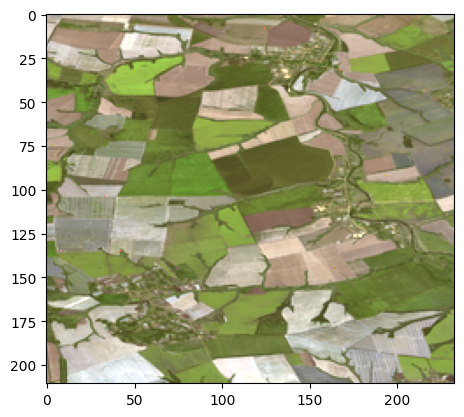

ValueError: 'r, g, b' is not a valid value for cmap; supported values are 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Grays', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_grey', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gist_yerg', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'grey', 'hot', 'hot_r', 'hsv', 'hsv_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'winter', 'winter_r'

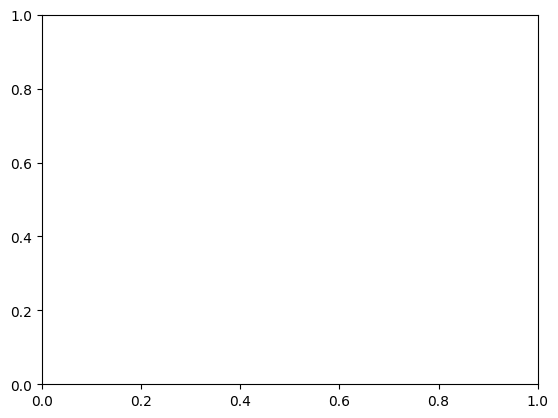

In [14]:
imshow(crops[0], 'r, g, b')
plt.show()
plt.imshow(fix(crop_scenes[0].row_img), 'r, g, b')
plt.show()

In [253]:
# base_scenes = []
# for b in bases:
#     base_scenes.append(Scene(b, 1))    

## Ищем пиксели по классам

In [8]:
scn = 3
image_scene = crop_scenes[scn]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.0..3.0].


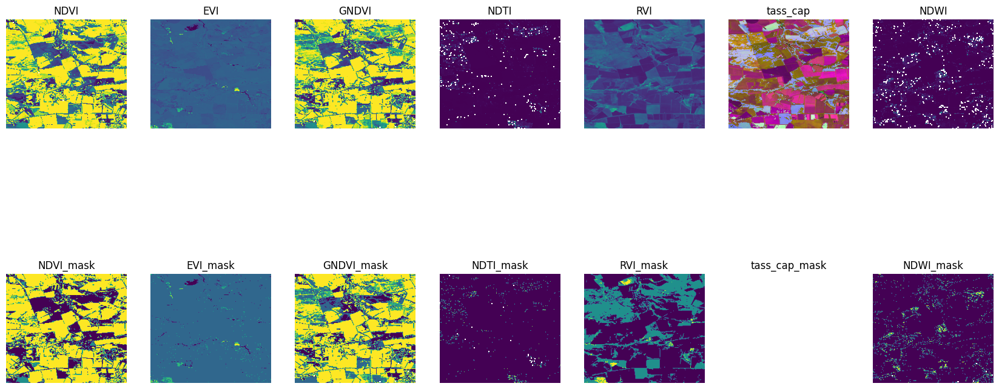

In [98]:
tass_cap_plot = normalized_filtered(image_scene.tass_cap, 'r, g, b')
images_plot = [image_scene.NDVI, image_scene.EVI, image_scene.GNDVI, image_scene.NDTI,  image_scene.RVI, tass_cap_plot, image_scene.NDWI,
               image_scene.NDVI_mask, image_scene.EVI_mask, image_scene.GNDVI_mask, image_scene.NDTI_mask, image_scene.RVI_mask, image_scene.tass_cap_mask[:, :, :-1], image_scene.NDWI_mask]
titles_plot = ['NDVI', 'EVI', 'GNDVI', 'NDTI', 'RVI', 'tass_cap', 'NDWI',
               'NDVI_mask', 'EVI_mask', 'GNDVI_mask', 'NDTI_mask', 'RVI_mask', 'tass_cap_mask', 'NDWI_mask']

fig = plt.figure(figsize=(21, 10))

# Создаем 3 ряда и 2 колонки субфигуров
for i in range(2):
    for j in range(7):
        # Создаем субфигур и индексируем его как i*3+j+1
        subfig = fig.add_subplot(2, 7, i*7+j+1)
        # Загружаем изображение и отображаем его в субфигуре
        subfig.imshow(images_plot[i*7+j])
        # Убираем все оси, кроме главной
        subfig.set_axis_off()
        subfig.set_title(f'{titles_plot[i*7+j]}')


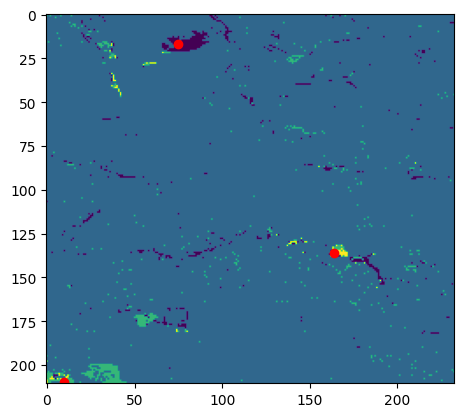

In [9]:
plt.imshow(image_scene.EVI_mask)
#plt.show()
#plt.imshow(image_scene.EVI_mask[200:, 0:50])    
point1 = [75, 17]
point2 = [164, 136]
point3 = [10, 210]
points = [point1, point2, point3]
#plt.scatter(points, points, c='white', marker='o')
plt.plot(point1[0],point1[1], 'ro')
plt.plot(point2[0],point2[1], 'ro')
plt.plot(point3[0],point3[1], 'ro')

Выводим значение маски в каждой конкретной точке

In [10]:
def print_values_in_point(point: list, image_scene: Scene):
    images_plot = [image_scene.NDVI, image_scene.EVI, image_scene.GNDVI, image_scene.RVI]
    masks_plot =  [image_scene.NDVI_mask, image_scene.EVI_mask, image_scene.GNDVI_mask, image_scene.RVI_mask]
                
    titles_plot = ['NDVI', 'EVI', 'GNDVI','RVI']
    print(f'For point {point}')
    for i in range(len(images_plot)):
        print(f'{titles_plot[i]}: {images_plot[i][point[0], point[1]]}')
        print(f'{titles_plot[i]}_mask: {masks_plot[i][point[0], point[1]]}')

In [11]:
def values_in_point(point: list, image_scene: Scene) -> dict:
    images_plot = [image_scene.NDVI, image_scene.EVI, image_scene.GNDVI, image_scene.RVI]
    masks_plot =  [image_scene.NDVI_mask, image_scene.EVI_mask, image_scene.GNDVI_mask, image_scene.RVI_mask]
    values_list = []            
    titles_plot = ['NDVI', 'EVI', 'GNDVI','RVI']
    print(f'For point {point}')
    for i in range(len(images_plot)):
        print(f'{titles_plot[i]}: {images_plot[i][point[0], point[1]]}')
        print(f'{titles_plot[i]}_mask: {masks_plot[i][point[0], point[1]]}')
        values_list.append(masks_plot[i][point[0], point[1]])
    return values_list
    

In [12]:
images_plot = [image_scene.NDVI, image_scene.EVI, image_scene.GNDVI, image_scene.RVI]
masks_plot =  [image_scene.NDVI_mask, image_scene.EVI_mask, image_scene.GNDVI_mask, image_scene.RVI_mask]
               
titles_plot = ['NDVI', 'EVI', 'GNDVI','RVI']
for point in points:
    print(f'For point {point}')
    for i in range(len(images_plot)):
        print(f'{titles_plot[i]}: {images_plot[i][point[0], point[1]]}')
        print(f'{titles_plot[i]}_mask: {masks_plot[i][point[0], point[1]]}')
    print("")

For point [75, 17]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.8139534883720931
EVI_mask: 2.0
GNDVI: 0.86
GNDVI_mask: 4.0
RVI: 1.9051724137931034
RVI_mask: 2.0

For point [164, 136]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -1.1303191489361701
EVI_mask: 2.0
GNDVI: 0.04504504504504504
GNDVI_mask: 1.0
RVI: 0.9914529914529915
RVI_mask: 1.0

For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0



Считаем для 16 точек занчения

[75, 17] [164, 136]
Interim point:1, with X:81 and Y:24
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [81, 24]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.8981001727115717
EVI_mask: 2.0
GNDVI: 0.7068965517241379
GNDVI_mask: 3.0
RVI: 1.8455284552845528
RVI_mask: 2.0
Interim point:2, with X:87 and Y:31
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [87, 31]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -2.557603686635945
EVI_mask: 1.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 2.2065217391304346
RVI_mask: 2.0
Interim point:3, with X:93 and Y:38
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [93, 38]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -1.049868766404199

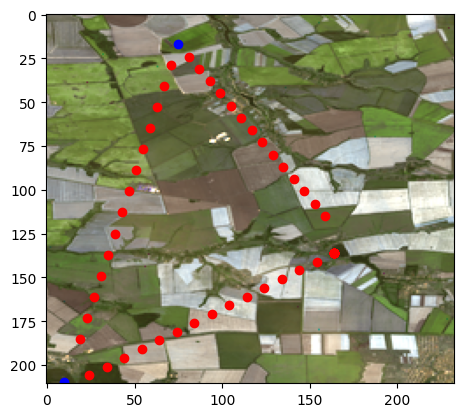

In [13]:
# Внимание нет провери на границу изображения!
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.plot(point1[0],point1[1], 'bo')
plt.plot(point2[0],point2[1], 'bo')
plt.plot(point3[0],point3[1], 'bo')
values_dict = {}
point_coord = []
points_counter = 0
n_point = 16
for start_point in [point1, point2]:
    for end_point in [point2, point3]:
        print(start_point, end_point)
        coef_x = -1 if start_point[0] > end_point[0] else 1
        coef_y = -1 if start_point[1] > end_point[1] else 1
        delta_x = round(abs(start_point[0]-end_point[0])/16)
        delta_y = round(abs(start_point[1]-end_point[1])/16)
        for ind in range(1, n_point-1):
            n_point_x = ind*delta_x*coef_x + start_point[0]
            n_point_y = ind*delta_y*coef_y + start_point[1]
            print(f'Interim point:{ind}, with X:{n_point_x} and Y:{n_point_y}')
            values_in_point(point, image_scene) 
            plt.plot(n_point_x,n_point_y, 'ro')
            point_coord.append([n_point_x, n_point_y])
            values_dict[points_counter] = values_in_point([n_point_x, n_point_y], image_scene)
            points_counter+=1

### Поиск точек на должожке

In [14]:
base_scenes = Scene(bases[0][:6000, :6000, :],1)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:16: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:16: RuntimeWarning: invalid value encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:29: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\922344816.py:29: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\L

In [15]:
base = base_scenes

In [35]:
pin_points = []
pin_points.append(values_in_point(point1, image_scene))
pin_points.append(values_in_point(point2, image_scene))
pin_points.append(values_in_point(point3, image_scene))

For point [75, 17]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.8139534883720931
EVI_mask: 2.0
GNDVI: 0.86
GNDVI_mask: 4.0
RVI: 1.9051724137931034
RVI_mask: 2.0
For point [75, 130]
NDVI: 0.9646017699115044
NDVI_mask: 4.0
EVI: -0.8245083207261725
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 0.7121212121212122
RVI_mask: 1.0
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0


In [17]:
base_values = np.dstack((base.NDVI_mask, base.EVI_mask, base.GNDVI_mask, base.RVI_mask))
print(base_values)

[[[2. 3. 1. 1.]
  [2. 3. 1. 1.]
  [2. 3. 1. 1.]
  ...
  [2. 2. 4. 2.]
  [2. 2. 4. 2.]
  [4. 2. 4. 2.]]

 [[2. 3. 1. 1.]
  [2. 3. 1. 1.]
  [2. 3. 1. 1.]
  ...
  [4. 2. 4. 2.]
  [4. 2. 4. 2.]
  [4. 1. 4. 2.]]

 [[2. 3. 1. 1.]
  [2. 3. 1. 1.]
  [2. 3. 1. 1.]
  ...
  [4. 2. 4. 2.]
  [4. 2. 4. 2.]
  [4. 2. 4. 2.]]

 ...

 [[2. 2. 2. 2.]
  [2. 2. 2. 2.]
  [3. 2. 2. 2.]
  ...
  [4. 2. 2. 1.]
  [4. 2. 2. 2.]
  [4. 2. 2. 2.]]

 [[2. 2. 2. 2.]
  [3. 2. 2. 2.]
  [3. 2. 2. 2.]
  ...
  [4. 2. 2. 1.]
  [4. 2. 2. 2.]
  [4. 2. 2. 1.]]

 [[2. 2. 2. 2.]
  [3. 2. 2. 2.]
  [3. 2. 2. 2.]
  ...
  [4. 2. 3. 1.]
  [4. 2. 2. 2.]
  [4. 2. 3. 2.]]]


In [18]:
# слои каналов лежат: NDVI, EVI, GNDVI, RVI
base_values.shape

(6000, 6000, 4)

In [19]:
pin_points

[[4.0, 2.0, 4.0, 2.0], [4.0, 2.0, 1.0, 1.0], [2.0, 2.0, 4.0, 1.0]]

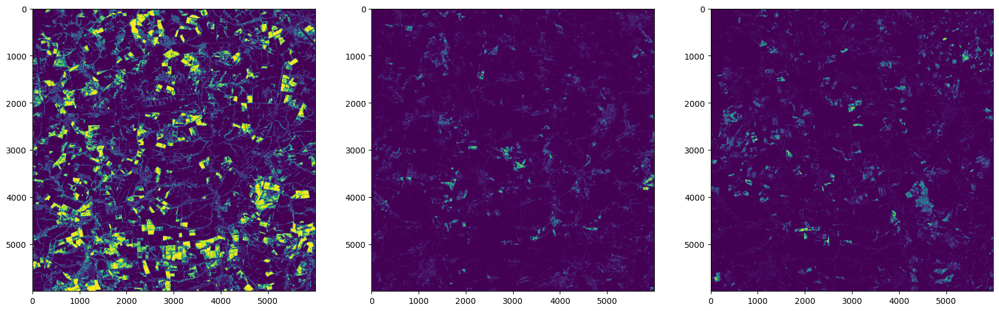

In [20]:
fig = plt.figure(figsize=(21, 10))

for ind in range(3):
    channel_conditions = [
        (base_values[:, :, 0] == pin_points[ind][0]),
        (base_values[:, :, 1] == pin_points[ind][1]),
        (base_values[:, :, 2] == pin_points[ind][2]),
        (base_values[:, :, 3] == pin_points[ind][3])
    ]

    # Создаем массив результатов для каждого канала
    results = np.array(channel_conditions)

    # Применяем np.all по всем каналам
    result = np.all(results, axis=0)

    subfig = fig.add_subplot(1, 3, ind+1)
    subfig.imshow(result)




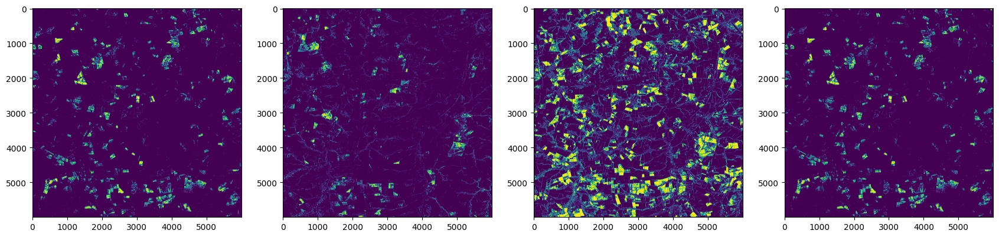

In [31]:
ind = 0
fig = plt.figure(figsize=(21, 10))
for i in range(14):
    channel_conditions = [
            (base_values[:, :, 0] == values_dict[ind][0]),
            (base_values[:, :, 1] == values_dict[ind][1]),
            (base_values[:, :, 2] == values_dict[ind][2]),
            (base_values[:, :, 3] == values_dict[ind][3])
        ]
    results = np.array(channel_conditions)

    # Применяем np.all по всем каналам
    result = np.all(results, axis=0)
    if (i==3) | (i==6) | (i==9) | (i==13):
        subfig = fig.add_subplot(1, 4, ind+1)
        subfig.imshow(result)
        ind+=1

{0: [4.0, 2.0, 3.0, 2.0],
 1: [4.0, 1.0, 4.0, 2.0],
 2: [4.0, 2.0, 4.0, 2.0],
 3: [4.0, 2.0, 3.0, 2.0],
 4: [4.0, 2.0, 4.0, 1.0],
 5: [4.0, 2.0, 4.0, 1.0],
 6: [4.0, 2.0, 4.0, 2.0],
 7: [4.0, 2.0, 4.0, 1.0],
 8: [2.0, 2.0, 1.0, 1.0],
 9: [4.0, 2.0, 4.0, 2.0],
 10: [4.0, 2.0, 4.0, 1.0],
 11: [4.0, 2.0, 4.0, 2.0],
 12: [4.0, 2.0, 4.0, 2.0],
 13: [4.0, 2.0, 4.0, 1.0],
 14: [4.0, 2.0, 4.0, 2.0],
 15: [4.0, 2.0, 4.0, 2.0],
 16: [2.0, 2.0, 2.0, 2.0],
 17: [2.0, 2.0, 2.0, 2.0],
 18: [2.0, 2.0, 2.0, 2.0],
 19: [2.0, 2.0, 1.0, 1.0],
 20: [3.0, 2.0, 2.0, 2.0],
 21: [2.0, 2.0, 1.0, 2.0],
 22: [4.0, 2.0, 3.0, 2.0],
 23: [4.0, 2.0, 4.0, 2.0],
 24: [2.0, 2.0, 1.0, 1.0],
 25: [4.0, 2.0, 3.0, 2.0],
 26: [4.0, 2.0, 4.0, 2.0],
 27: [4.0, 2.0, 3.0, 2.0],
 28: [4.0, 2.0, 1.0, 1.0],
 29: [4.0, 2.0, 1.0, 1.0],
 30: [4.0, 2.0, 1.0, 1.0],
 31: [4.0, 2.0, 1.0, 1.0],
 32: [4.0, 2.0, 1.0, 1.0],
 33: [4.0, 2.0, 1.0, 1.0],
 34: [4.0, 2.0, 1.0, 1.0],
 35: [4.0, 2.0, 1.0, 1.0],
 36: [4.0, 2.0, 1.0, 1.0],
 37: [4.0, 

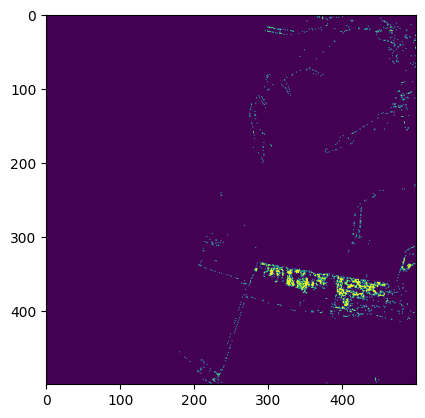

In [25]:
plt.imshow(result[0:500, 0:500])
values_dict

### Пробуем взять точки по вертикали

In [ ]:
plt.imshow(image_scene.EVI_mask)
#plt.show()
#plt.imshow(image_scene.EVI_mask[200:, 0:50])    
point1 = [75, 17]
point2 = [164, 136]
point3 = [10, 210]
points = [point1, point2, point3]
#plt.scatter(points, points, c='white', marker='o')
plt.plot(point1[0],point1[1], 'ro')
plt.plot(point2[0],point2[1], 'ro')
plt.plot(point3[0],point3[1], 'ro')

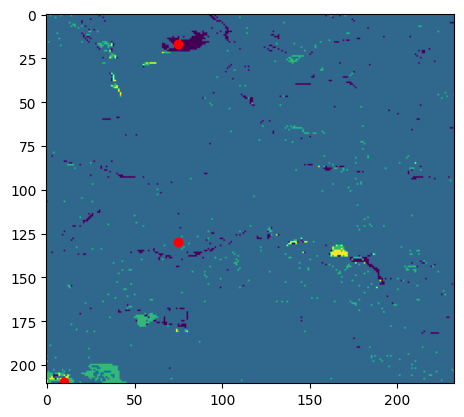

In [33]:
plt.imshow(image_scene.EVI_mask)
#plt.show()
#plt.imshow(image_scene.EVI_mask[200:, 0:50])    
point1 = [75, 17]
point2 = [75, 130]
point3 = [10, 210]
points = [point1, point2, point3]
#plt.scatter(points, points, c='white', marker='o')
plt.plot(point1[0],point1[1], 'ro')
plt.plot(point2[0],point2[1], 'ro')
plt.plot(point3[0],point3[1], 'ro')

[75, 17] [75, 130]
Interim point:1, with X:75 and Y:24
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [75, 24]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -1.1458333333333333
EVI_mask: 2.0
GNDVI: 0.78125
GNDVI_mask: 3.0
RVI: 2.0
RVI_mask: 2.0
Interim point:2, with X:75 and Y:31
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [75, 31]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -1.2430426716141003
EVI_mask: 2.0
GNDVI: 0.904
GNDVI_mask: 4.0
RVI: 2.185840707964602
RVI_mask: 2.0
Interim point:3, with X:75 and Y:38
For point [10, 210]
NDVI: 0.08943089430894309
NDVI_mask: 2.0
EVI: -0.01656626506024096
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 1.059782608695652
RVI_mask: 1.0
For point [75, 38]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.5511811023622047
EVI_mask: 2.0
GNDVI: 1.

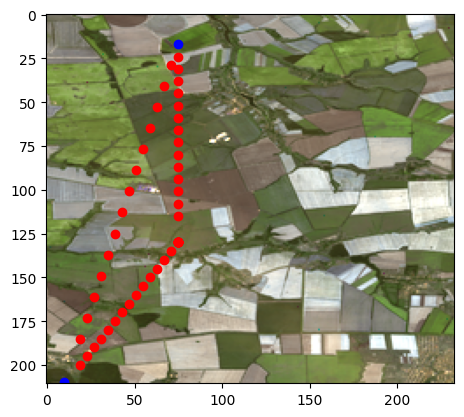

In [34]:
# Внимание нет провери на границу изображения!
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.plot(point1[0],point1[1], 'bo')
plt.plot(point2[0],point2[1], 'bo')
plt.plot(point3[0],point3[1], 'bo')
values_dict = {}
point_coord = []
points_counter = 0
n_point = 16
for start_point in [point1, point2]:
    for end_point in [point2, point3]:
        print(start_point, end_point)
        coef_x = -1 if start_point[0] > end_point[0] else 1
        coef_y = -1 if start_point[1] > end_point[1] else 1
        delta_x = round(abs(start_point[0]-end_point[0])/16)
        delta_y = round(abs(start_point[1]-end_point[1])/16)
        for ind in range(1, n_point-1):
            n_point_x = ind*delta_x*coef_x + start_point[0]
            n_point_y = ind*delta_y*coef_y + start_point[1]
            print(f'Interim point:{ind}, with X:{n_point_x} and Y:{n_point_y}')
            values_in_point(point, image_scene) 
            plt.plot(n_point_x,n_point_y, 'ro')
            point_coord.append([n_point_x, n_point_y])
            values_dict[points_counter] = values_in_point([n_point_x, n_point_y], image_scene)
            points_counter+=1

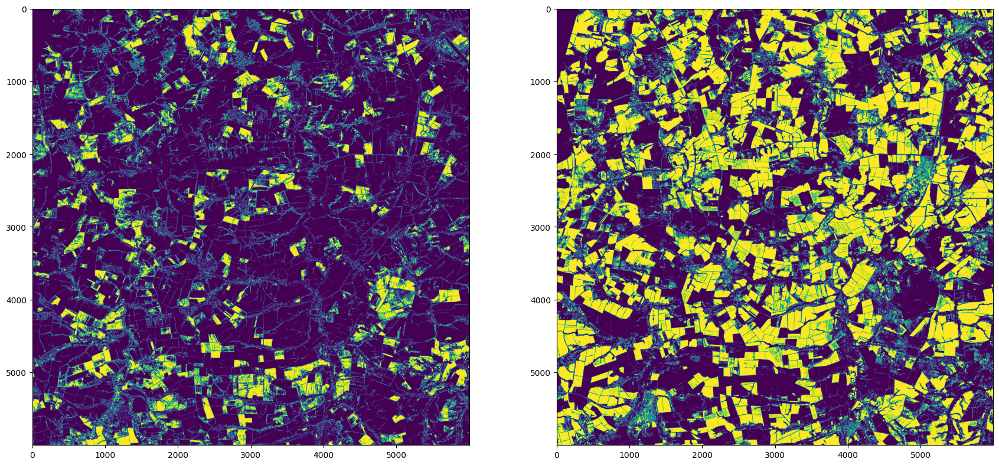

In [36]:
fig = plt.figure(figsize=(21, 10))

for ind in range(2):
    channel_conditions = [
        (base_values[:, :, 0] == pin_points[ind][0]),
        (base_values[:, :, 1] == pin_points[ind][1]),
        (base_values[:, :, 2] == pin_points[ind][2]),
        (base_values[:, :, 3] == pin_points[ind][3])
    ]

    # Создаем массив результатов для каждого канала
    results = np.array(channel_conditions)

    # Применяем np.all по всем каналам
    result = np.all(results, axis=0)

    subfig = fig.add_subplot(1, 2, ind+1)
    subfig.imshow(result)




[4.0, 2.0, 3.0, 2.0]
[4.0, 2.0, 4.0, 2.0]
[4.0, 2.0, 4.0, 2.0]
[4.0, 2.0, 3.0, 2.0]
[4.0, 2.0, 4.0, 2.0]


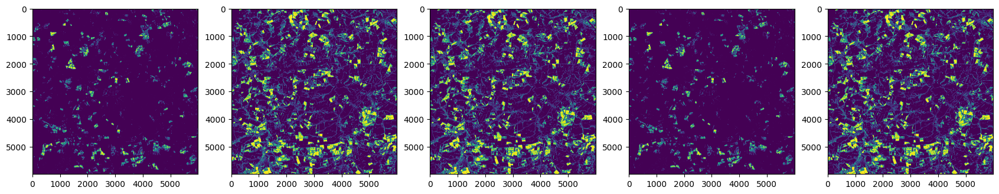

In [43]:
fig = plt.figure(figsize=(21, 10))
ind = 0
for k in range(5):
    print(values_dict[k])
    channel_conditions = [
        (base_values[:, :, 0] == values_dict[ind][0]),
        (base_values[:, :, 1] == values_dict[ind][1]),
        (base_values[:, :, 2] == values_dict[ind][2]),
        (base_values[:, :, 3] == values_dict[ind][3])
    ]

    # Создаем массив результатов для каждого канала
    results = np.array(channel_conditions)

    # Применяем np.all по всем каналам
    result = np.all(results, axis=0)

    subfig = fig.add_subplot(1, 5, ind+1)
    ind+=1
    subfig.imshow(result)

## Пробуем на одном слое выделить все подходящие точки

In [212]:
scn = 0
image_scene = crop_scenes[scn]

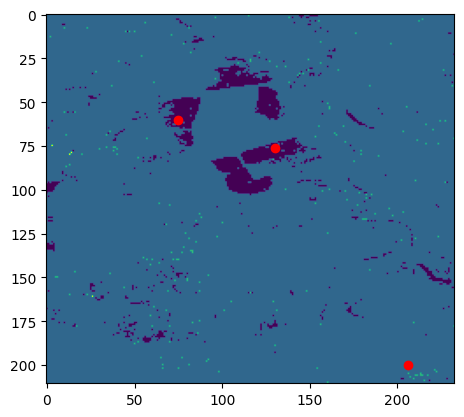

In [214]:
plt.imshow(image_scene.EVI_mask)
#plt.show()
#plt.imshow(image_scene.EVI_mask[200:, 0:50])    
point1 = [75, 60]
point2 = [130, 76]
point3 = [206, 200]
points = [point1, point2, point3]
#plt.scatter(points, points, c='white', marker='o')
plt.plot(point1[0],point1[1], 'ro')
plt.plot(point2[0],point2[1], 'ro')
plt.plot(point3[0],point3[1], 'ro')

In [215]:
pin_points = []
pin_points.append(values_in_point(point1, image_scene))
pin_points.append(values_in_point(point2, image_scene))
pin_points.append(values_in_point(point3, image_scene))

For point [75, 60]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.43478260869565216
EVI_mask: 2.0
GNDVI: 0.6551724137931034
GNDVI_mask: 3.0
RVI: 1.5172413793103448
RVI_mask: 2.0
For point [130, 76]
NDVI: 0.9838056680161943
NDVI_mask: 4.0
EVI: -1.3135135135135134
EVI_mask: 2.0
GNDVI: 0.9678714859437751
GNDVI_mask: 4.0
RVI: 0.9
RVI_mask: 1.0
For point [206, 200]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.7327227310574522
EVI_mask: 2.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 0.3442622950819672
RVI_mask: 1.0


[75, 60] [130, 76]
Interim point:1, with X:78 and Y:61
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [78, 61]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.5068078668683813
EVI_mask: 2.0
GNDVI: 0.6923076923076923
GNDVI_mask: 3.0
RVI: 1.5775862068965518
RVI_mask: 2.0
Interim point:2, with X:81 and Y:62
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [81, 62]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -3.5517241379310343
EVI_mask: 1.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 2.095744680851064
RVI_mask: 2.0
Interim point:3, with X:84 and Y:63
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [84, 63]
NDVI: 0.05357142857142857
NDVI_mask: 2.0
EVI: -0.

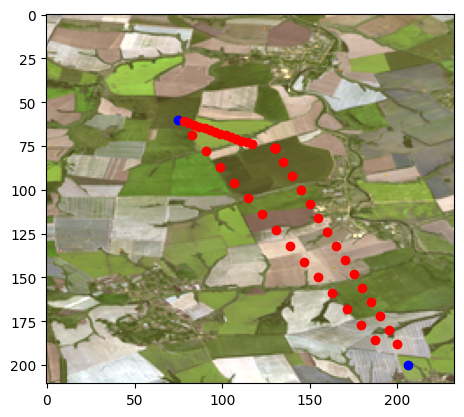

In [216]:
# Внимание нет провери на границу изображения!
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.plot(point1[0],point1[1], 'bo')
plt.plot(point2[0],point2[1], 'bo')
plt.plot(point3[0],point3[1], 'bo')
values_dict = {}
point_coord = []
points_counter = 0
n_point = 16
for start_point in [point1, point2]:
    for end_point in [point2, point3]:
        print(start_point, end_point)
        coef_x = -1 if start_point[0] > end_point[0] else 1
        coef_y = -1 if start_point[1] > end_point[1] else 1
        delta_x = round(abs(start_point[0]-end_point[0])/16)
        delta_y = round(abs(start_point[1]-end_point[1])/16)
        for ind in range(1, n_point-1):
            n_point_x = ind*delta_x*coef_x + start_point[0]
            n_point_y = ind*delta_y*coef_y + start_point[1]
            print(f'Interim point:{ind}, with X:{n_point_x} and Y:{n_point_y}')
            values_in_point(point, image_scene) 
            plt.plot(n_point_x,n_point_y, 'ro')
            point_coord.append([n_point_x, n_point_y])
            values_dict[points_counter] = values_in_point([n_point_x, n_point_y], image_scene)
            points_counter+=1

In [217]:
print(pin_points)
print(values_dict)
# выделяем уникальные компзии слоёв
uniq_values = []
tmp = pin_points.copy()
tmp.extend(list(values_dict.values()))
for lst in tmp:
    if lst not in uniq_values:
        uniq_values.append(lst)
        
print(uniq_values)
classes_NDVI = []
classes_EVI = []
classes_GNDVI = []
classes_RVI = []
for lst in uniq_values:
    print(lst)
    classes_NDVI.append(lst[0])
    classes_EVI.append(lst[1])
    classes_GNDVI.append(lst[2])
    classes_RVI.append(lst[3])


[[4.0, 2.0, 3.0, 2.0], [4.0, 2.0, 4.0, 1.0], [4.0, 2.0, 4.0, 1.0]]
{0: [4.0, 2.0, 3.0, 2.0], 1: [4.0, 1.0, 4.0, 2.0], 2: [2.0, 2.0, 1.0, 1.0], 3: [4.0, 2.0, 4.0, 2.0], 4: [4.0, 2.0, 4.0, 2.0], 5: [4.0, 2.0, 3.0, 2.0], 6: [4.0, 2.0, 4.0, 2.0], 7: [4.0, 2.0, 4.0, 2.0], 8: [4.0, 2.0, 4.0, 2.0], 9: [4.0, 2.0, 4.0, 1.0], 10: [2.0, 2.0, 2.0, 1.0], 11: [4.0, 2.0, 4.0, 1.0], 12: [4.0, 2.0, 4.0, 1.0], 13: [4.0, 2.0, 4.0, 1.0], 14: [2.0, 2.0, 1.0, 1.0], 15: [4.0, 2.0, 2.0, 2.0], 16: [4.0, 2.0, 2.0, 2.0], 17: [4.0, 2.0, 4.0, 1.0], 18: [4.0, 2.0, 2.0, 2.0], 19: [4.0, 2.0, 2.0, 2.0], 20: [4.0, 2.0, 4.0, 1.0], 21: [4.0, 2.0, 4.0, 1.0], 22: [4.0, 2.0, 3.0, 1.0], 23: [2.0, 2.0, 1.0, 1.0], 24: [4.0, 2.0, 4.0, 1.0], 25: [4.0, 2.0, 4.0, 1.0], 26: [4.0, 2.0, 4.0, 1.0], 27: [4.0, 2.0, 4.0, 1.0], 28: [4.0, 2.0, 4.0, 1.0], 29: [4.0, 2.0, 4.0, 1.0], 30: [4.0, 2.0, 4.0, 1.0], 31: [4.0, 2.0, 4.0, 1.0], 32: [4.0, 2.0, 4.0, 1.0], 33: [4.0, 2.0, 4.0, 1.0], 34: [4.0, 2.0, 4.0, 1.0], 35: [4.0, 2.0, 4.0, 1.0], 36: [4

In [218]:
classes_NDVI = list(set(classes_NDVI))
classes_EVI = list(set(classes_EVI))
classes_GNDVI = list(set(classes_GNDVI))
classes_RVI = list(set(classes_RVI))

In [194]:
classes_EVI

[1.0, 2.0]

(-0.5, 232.5, 210.5, -0.5)

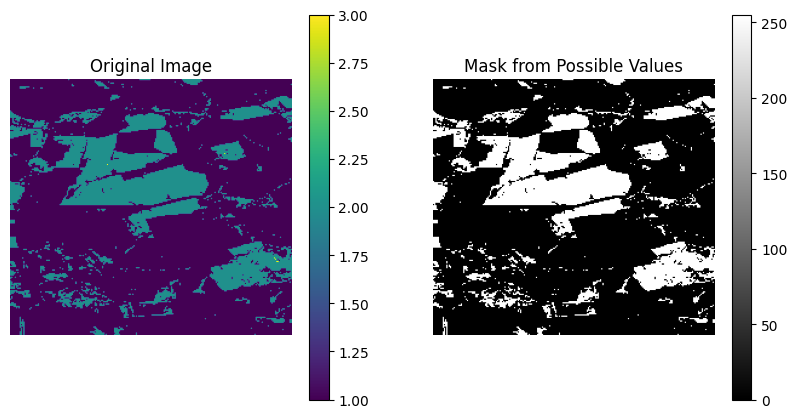

In [231]:
image = image_scene.RVI_mask
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_RVI:
    current_mask = cv2.inRange(image, value, value)
    mask_RVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_RVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

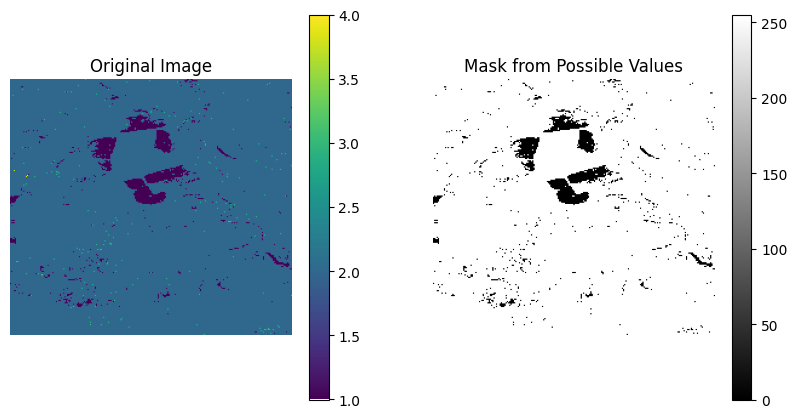

In [232]:
image = image_scene.EVI_mask
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_EVI:
    current_mask = cv2.inRange(image, value, value)
    mask_EVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_EVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

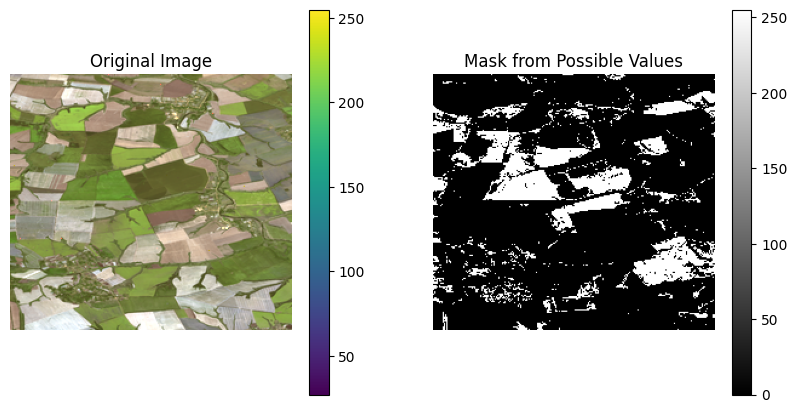

In [234]:
combined_mask = cv2.bitwise_and(mask_RVI, mask_EVI)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(combined_mask, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

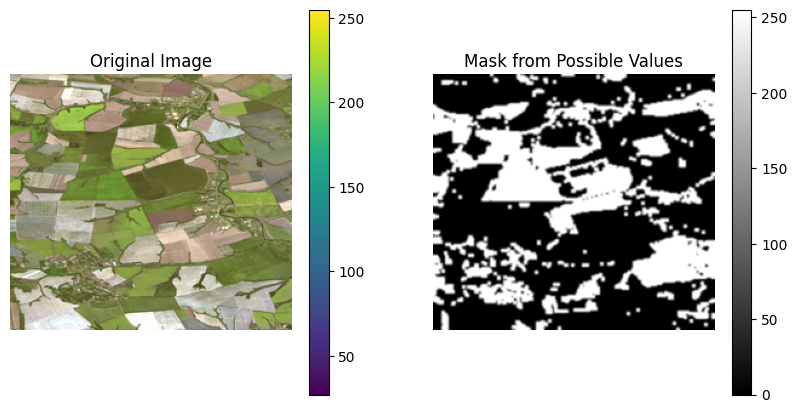

In [236]:
# Увеличить границы маски на 150 пикселей с помощью дилатации
kernel_size = 2 * 1 + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)
dilated_mask = cv2.dilate(combined_mask, kernel)

# Размыть увеличенную маску для сглаживания границ
blurred_mask = cv2.GaussianBlur(dilated_mask, (kernel_size, kernel_size), 0)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(blurred_mask, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

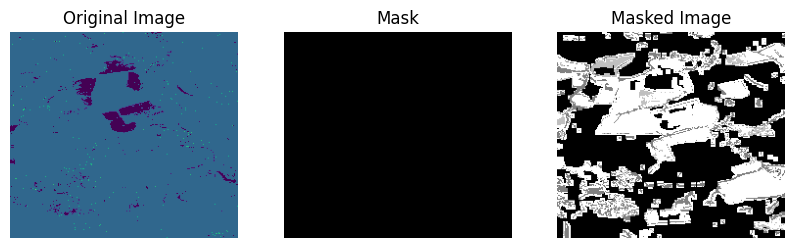

In [237]:
masked_image = cv2.bitwise_and(image_scene.NDVI_mask, image_scene.NDVI_mask, mask=blurred_mask)
# Отображение результатов
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(masked_image, cmap='gray')
plt.title('Masked Image')
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

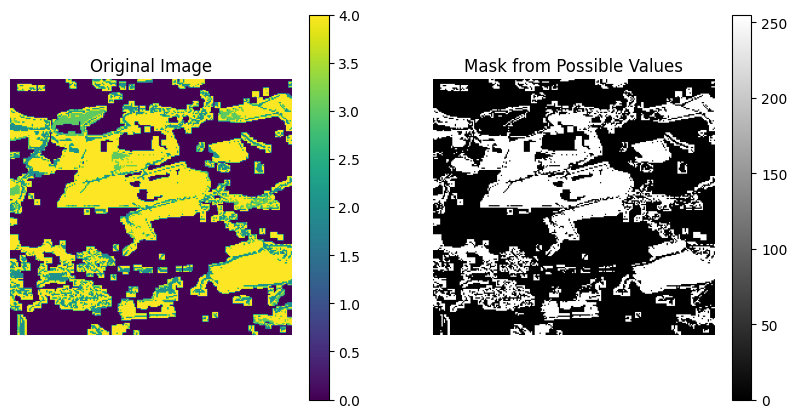

In [239]:
image = masked_image
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_NDVI:
    current_mask = cv2.inRange(image, value, value)
    mask_NDVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(masked_image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_NDVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

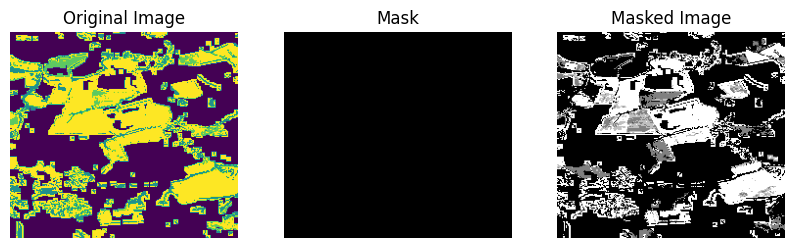

In [240]:
masked_image = cv2.bitwise_and(image_scene.GNDVI_mask, image_scene.GNDVI_mask, mask=mask_NDVI)
# Отображение результатов
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(masked_image, cmap='gray')
plt.title('Masked Image')
plt.axis('off')

(-0.5, 232.5, 210.5, -0.5)

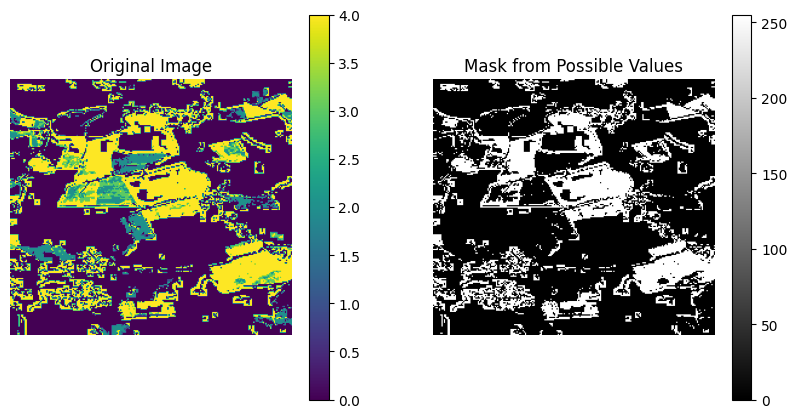

In [241]:
image = masked_image
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_GNDVI:
    current_mask = cv2.inRange(image, value, value)
    mask_GNDVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(masked_image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_GNDVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

###  Делаем для подлжоки

(-0.5, 5999.5, 5999.5, -0.5)

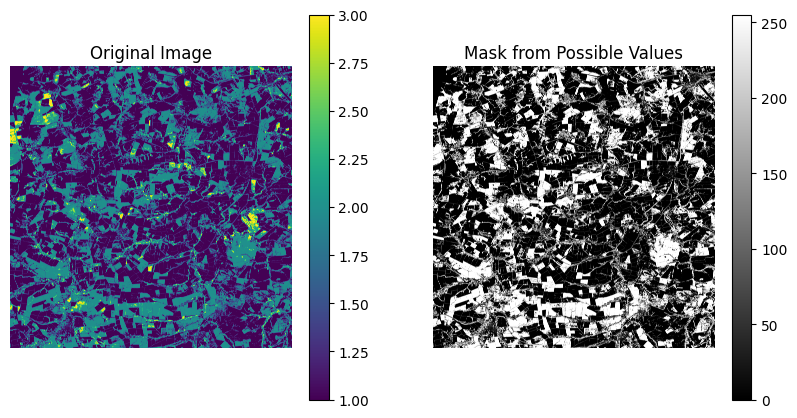

In [219]:
image = base.RVI_mask
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_RVI:
    current_mask = cv2.inRange(image, value, value)
    mask_RVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(base.RVI_mask)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_RVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

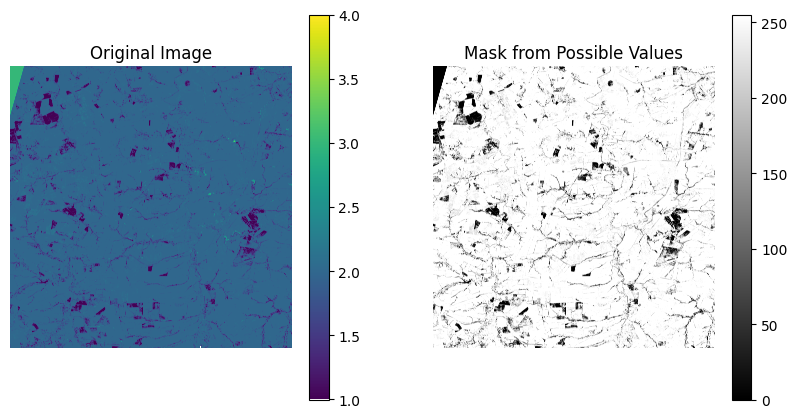

In [220]:
image = base.EVI_mask
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_EVI:
    current_mask = cv2.inRange(image, value, value)
    mask_EVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(base.EVI_mask)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_EVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

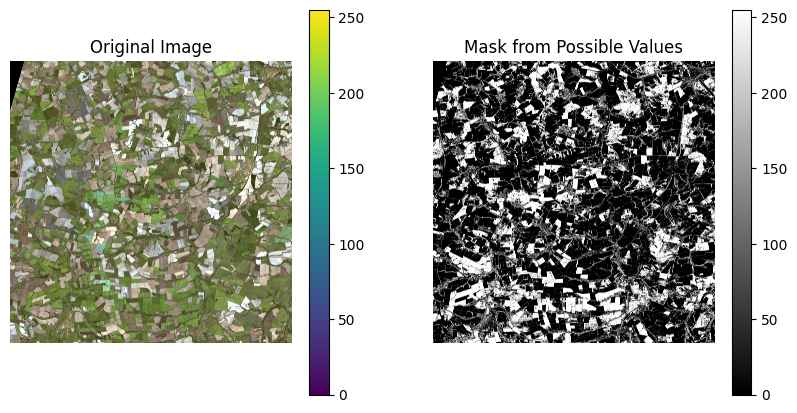

In [221]:
combined_mask = cv2.bitwise_and(mask_RVI, mask_EVI)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(normalized_filtered(base.img, 'r, g, b'))
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(combined_mask, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

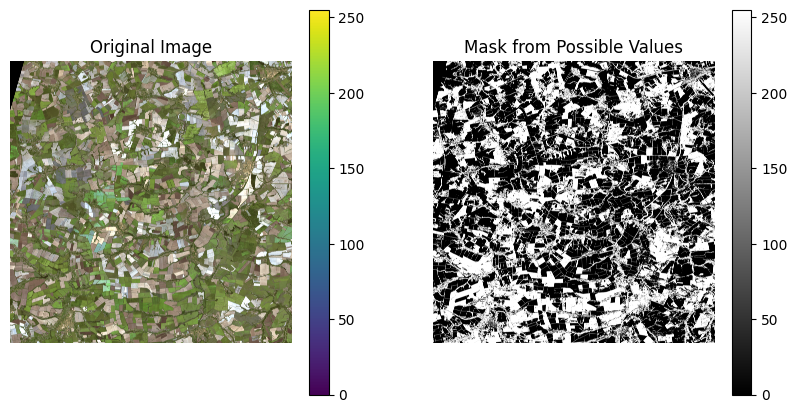

In [222]:
# Увеличить границы маски на 150 пикселей с помощью дилатации
kernel_size = 2 * 1 + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)
dilated_mask = cv2.dilate(combined_mask, kernel)

# Размыть увеличенную маску для сглаживания границ
blurred_mask = cv2.GaussianBlur(dilated_mask, (kernel_size, kernel_size), 0)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(normalized_filtered(base.img, 'r, g, b'))
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(blurred_mask, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

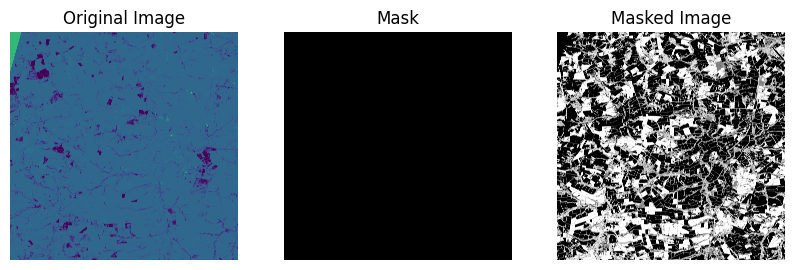

In [223]:
masked_image = cv2.bitwise_and(base.NDVI_mask, base.NDVI_mask, mask=blurred_mask)
# Отображение результатов
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(masked_image, cmap='gray')
plt.title('Masked Image')
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

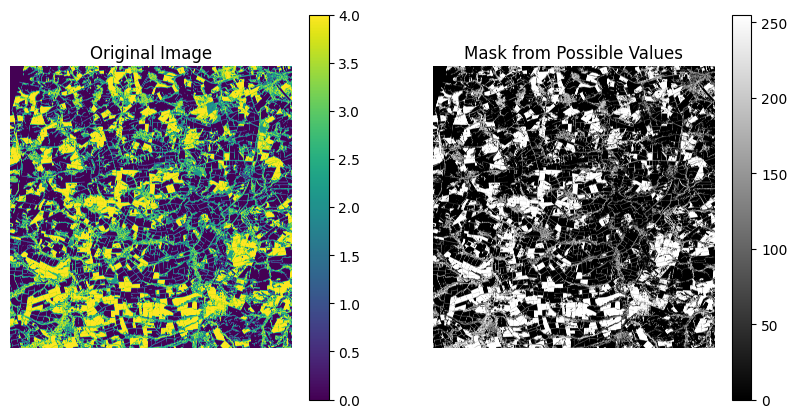

In [224]:
image = masked_image
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_NDVI:
    current_mask = cv2.inRange(image, value, value)
    mask_NDVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(masked_image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_NDVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

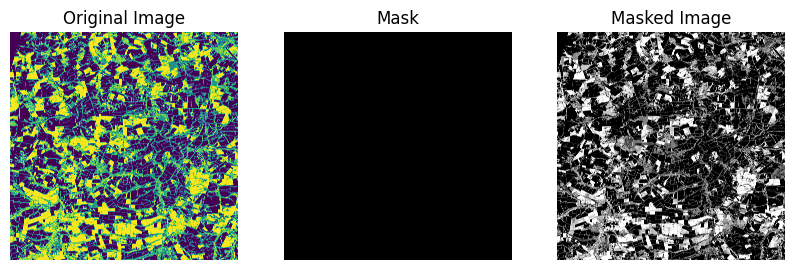

In [225]:
masked_image = cv2.bitwise_and(base.GNDVI_mask, base.GNDVI_mask, mask=mask_NDVI)
# Отображение результатов
plt.figure(figsize=(10, 5))
plt.subplot(1, 3, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(masked_image, cmap='gray')
plt.title('Masked Image')
plt.axis('off')

(-0.5, 5999.5, 5999.5, -0.5)

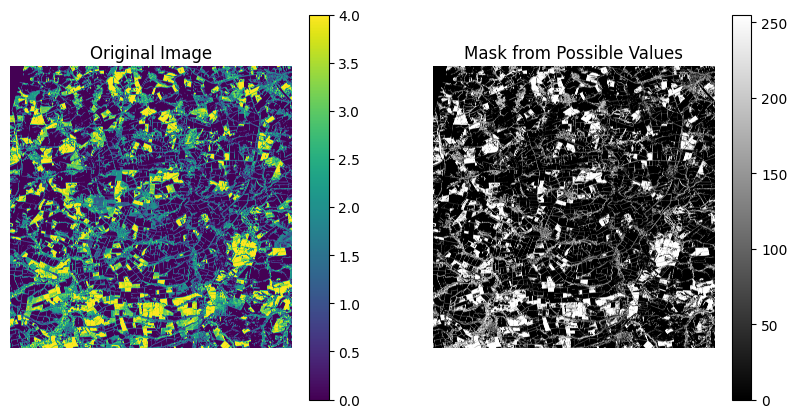

In [226]:
image = masked_image
mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)

# Проверка каждого пикселя изображения на соответствие значениям из списка
for value in classes_GNDVI:
    current_mask = cv2.inRange(image, value, value)
    mask_GNDVI = cv2.bitwise_or(mask, current_mask)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(masked_image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_GNDVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

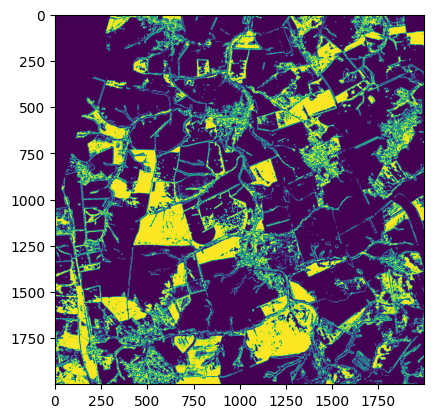

(array([2890877.,       0.,       0.,       0.,       0.,       0.,
              0.,       0.,       0., 1109123.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <BarContainer object of 10 artists>)

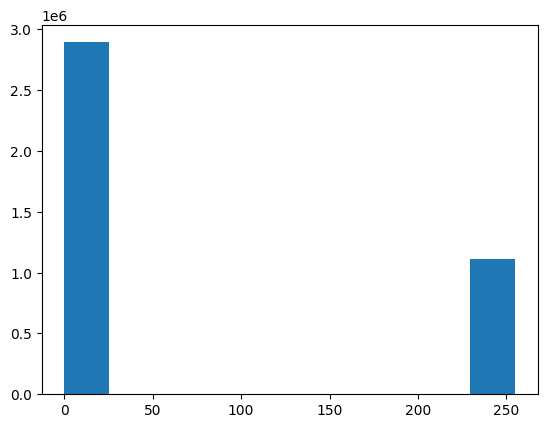

In [227]:
plt.imshow(mask_GNDVI[:2000, :2000])
plt.show()
plt.hist(mask_GNDVI[:2000, :2000].ravel())

(-0.5, 5999.5, 5999.5, -0.5)

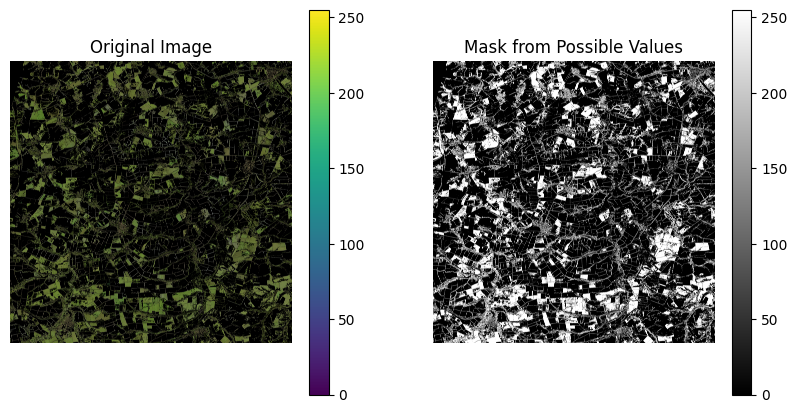

In [229]:
image = normalized_filtered(base.img, 'r, g, b')
masked_image = cv2.bitwise_and(image, image, mask=mask_GNDVI)



plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(masked_image)
plt.colorbar()
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(mask_GNDVI, cmap='gray')
plt.title('Mask from Possible Values')
plt.colorbar()
plt.axis('off')

## Посмотрим, можно ли разбить на классы из разных индексов

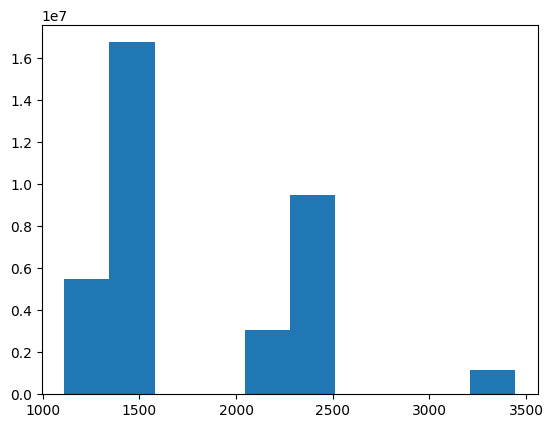

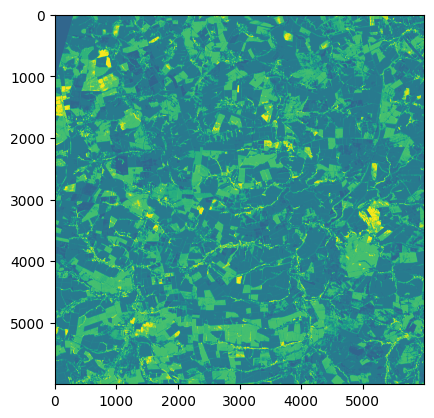

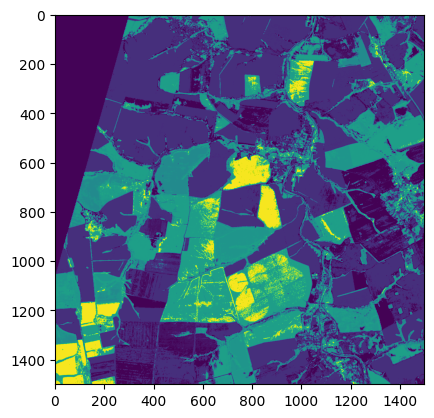

(array([1.0000000e+00, 0.0000000e+00, 0.0000000e+00, 5.4815380e+06,
        1.6772959e+07, 0.0000000e+00, 4.3978260e+06, 8.1690390e+06,
        0.0000000e+00, 1.1786370e+06]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

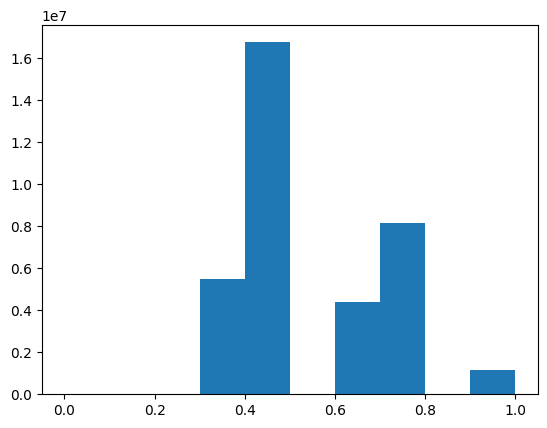

In [257]:
new_classes = base.NDVI_mask + 10*base.EVI_mask + 100*base.GNDVI_mask + 1000*base.RVI_mask
plt.hist(new_classes.ravel())
plt.show()
new_classes = np.nan_to_num(new_classes)
plt.imshow(new_classes/np.max(new_classes))
plt.show()
plt.imshow((new_classes/np.max(new_classes))[0:1500, 0:1500])
plt.show()
plt.hist((new_classes/np.max(new_classes)).ravel())

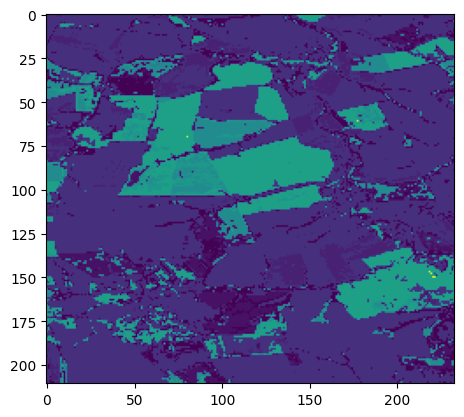

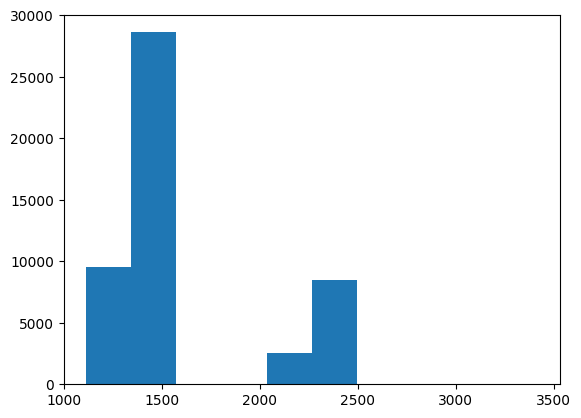

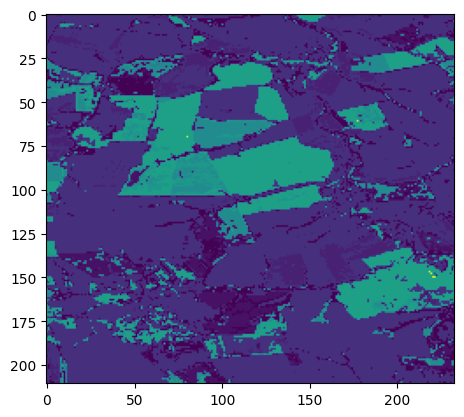

(array([9.5160e+03, 2.8601e+04, 0.0000e+00, 0.0000e+00, 2.5810e+03,
        8.4590e+03, 0.0000e+00, 0.0000e+00, 0.0000e+00, 6.0000e+00]),
 array([0.32630346, 0.39367311, 0.46104277, 0.52841242, 0.59578207,
        0.66315173, 0.73052138, 0.79789104, 0.86526069, 0.93263035,
        1.        ]),
 <BarContainer object of 10 artists>)

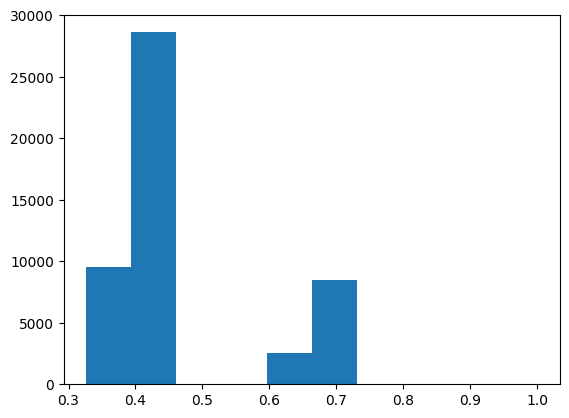

In [255]:
new_classes = image_scene.NDVI_mask + 10*image_scene.EVI_mask + 100*image_scene.GNDVI_mask + 1000*image_scene.RVI_mask
plt.imshow(new_classes)
plt.show()
plt.hist(new_classes.ravel())
plt.show()
new_classes = np.nan_to_num(new_classes)
plt.imshow(new_classes/np.max(new_classes))
plt.show()
plt.hist((new_classes/np.max(new_classes)).ravel())

## Пробуем смотреть классы по rgb

In [263]:
point1 = [50, 70]
point2 = [50, 200]
point3 = [200, 70]

[50, 70] [50, 200]
Interim point:1, with X:50 and Y:78
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [50, 78]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -3.9615384615384612
EVI_mask: 1.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 2.095744680851064
RVI_mask: 2.0
Interim point:2, with X:50 and Y:86
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [50, 86]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -3.493150684931507
EVI_mask: 1.0
GNDVI: 1.0
GNDVI_mask: 4.0
RVI: 2.096774193548387
RVI_mask: 2.0
Interim point:3, with X:50 and Y:94
For point [10, 210]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.41601255886970173
EVI_mask: 2.0
GNDVI: 0.3611111111111111
GNDVI_mask: 2.0
RVI: 1.4274193548387097
RVI_mask: 1.0
For point [50, 94]
NDVI: 1.0
NDVI_mask: 4.0
EVI: -0.3136842105263158
EVI_mask: 2.0
GN

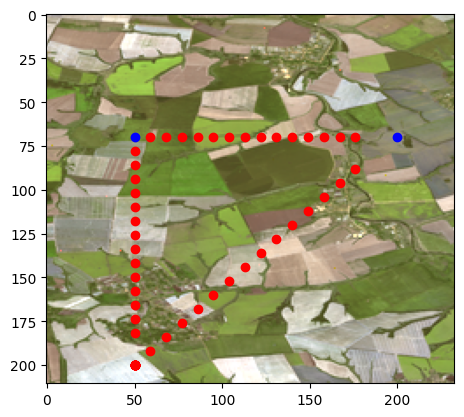

In [264]:
# Внимание нет провери на границу изображения!
plt.imshow(normalized_filtered(image_scene.img, 'r, g, b'))
plt.plot(point1[0],point1[1], 'bo')
plt.plot(point2[0],point2[1], 'bo')
plt.plot(point3[0],point3[1], 'bo')
values_dict = {}
point_coord = []
points_counter = 0
n_point = 16
for start_point in [point1, point2]:
    for end_point in [point2, point3]:
        print(start_point, end_point)
        coef_x = -1 if start_point[0] > end_point[0] else 1
        coef_y = -1 if start_point[1] > end_point[1] else 1
        delta_x = round(abs(start_point[0]-end_point[0])/16)
        delta_y = round(abs(start_point[1]-end_point[1])/16)
        for ind in range(1, n_point-1):
            n_point_x = ind*delta_x*coef_x + start_point[0]
            n_point_y = ind*delta_y*coef_y + start_point[1]
            print(f'Interim point:{ind}, with X:{n_point_x} and Y:{n_point_y}')
            values_in_point(point, image_scene) 
            plt.plot(n_point_x,n_point_y, 'ro')
            point_coord.append([n_point_x, n_point_y])
            values_dict[points_counter] = values_in_point([n_point_x, n_point_y], image_scene)
            points_counter+=1

In [273]:
point1_values = list(normalized_filtered(image_scene.img, 'r, g, b')[point1[0], point2[1], :])
point1_values

[120, 118, 104]

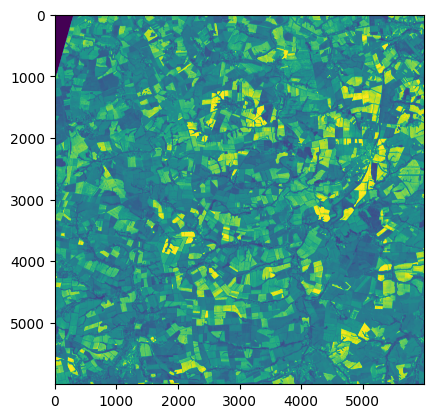

In [276]:
base_image = base
base_image_mask = base_image.img[:, :, 0]
base_image_mask[(base_image_mask>point1_values[0]-10) & (base_image_mask<point1_values[0]+10)]
plt.imshow(base_image_mask)

In [ ]:
mask_NDVI = base.NDVI_mask


channel_conditions = [
        (base_values[:, :, 0] == values_dict[ind][0]),
        (base_values[:, :, 1] == values_dict[ind][1]),
        (base_values[:, :, 2] == values_dict[ind][2]),
        (base_values[:, :, 3] == values_dict[ind][3])
    ]

    # Создаем массив результатов для каждого канала
    results = np.array(channel_conditions)

    # Применяем np.all по всем каналам
    result = np.all(results, axis=0)



### Пересечение всех подмасок промежуточных пикселей  

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\1411060985.py:36: RuntimeWarning: invalid value encountered in cast
  channel = channel.astype(np.uint8)


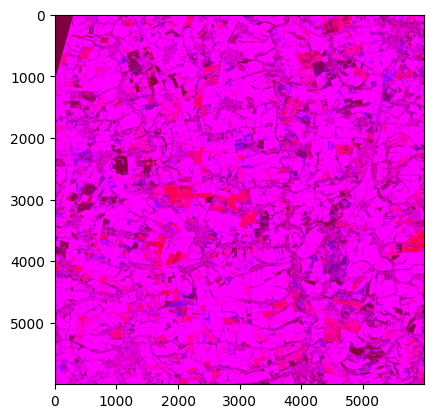

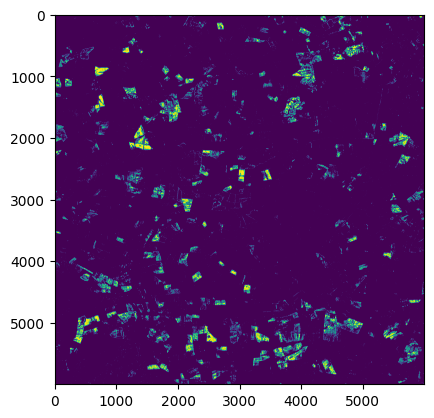

In [109]:
# Загрузка изображения
image = base_values

# Убедиться, что изображение загружено и имеет 4 канала
if image is None or image.shape[2] != 4:
    raise ValueError("Image could not be loaded or does not have 4 channels.")

# Список значений для фильтрации (предполагается, что они даны)
values_list = [pin_points[0], values_dict[0]]#, values_dict[0], values_dict[1]]#, values_dict[2], values_dict[18], values_dict[20], values_dict[4], values_dict[5], values_dict[6], values_dict[7], values_dict[8], values_dict[9], values_dict[10]]

# Создание масок для каждого значения
masks = []
for value in values_list:
    mask = cv2.inRange(image, np.array(value), np.array(value))
    masks.append(mask)

# Создание итоговой маски
final_mask = np.zeros_like(masks[0])

# Радиус поиска для определения соседства
radius = 20
kernel_size = 2 * radius + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)

# Итеративное нахождение границ между областями
for i in range(len(masks) - 1):
    for j in range(i + 1, len(masks)):
        mask1 = masks[i]
        mask2 = masks[j]
        
        # Расширение областей первой маски
        dilated_mask1 = cv2.dilate(mask1, kernel)
        
        # Пересечение расширенных областей первой маски со второй маской
        intersection = cv2.bitwise_and(dilated_mask1, mask2)
        
        # Добавление пересечения в итоговую маску
        final_mask = cv2.bitwise_or(final_mask, intersection)


imshow(base_values, 'r, g, b')
plt.imshow(final_mask)
# # Отображение результатов
# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGRA2RGBA))
# plt.title('Original Image')
# plt.axis('off')

# plt.subplot(1, 2, 2)
# plt.imshow(final_mask, cmap='gray')
# plt.title('Final Mask with Adjacent Regions')
# plt.axis('off')

plt.show()


In [110]:
final_mask.shape

(6000, 6000)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\2549741942.py:4: RuntimeWarning: invalid value encountered in cast
  masked_image = cv2.bitwise_and(base_values.astype(np.uint8), mask_4channel)


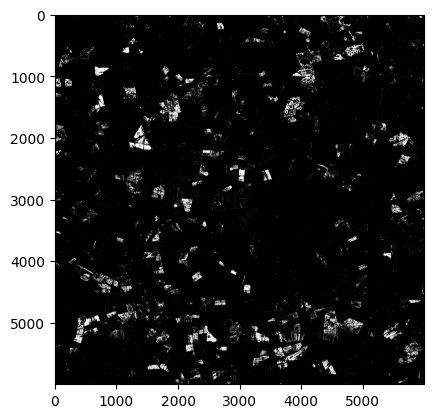

In [111]:
mask_4channel = cv2.merge([final_mask, final_mask, final_mask, final_mask])

# Наложение маски на изображение
masked_image = cv2.bitwise_and(base_values.astype(np.uint8), mask_4channel)
imshow(masked_image, 'r, g, b')



(array([1.3877922e+08, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 2.6103900e+06, 0.0000000e+00, 1.3051950e+06,
        0.0000000e+00, 1.3051950e+06]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. , 2.4, 2.8, 3.2, 3.6, 4. ]),
 <BarContainer object of 10 artists>)

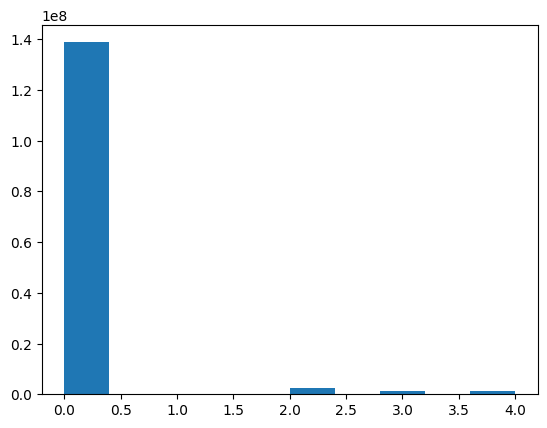

In [112]:
plt.hist(masked_image.ravel())

In [115]:
binary_mask = cv2.cvtColor(mask_4channel, cv2.COLOR_BGRA2GRAY)
binary_mask = cv2.threshold(binary_mask, 1, 255, cv2.THRESH_BINARY)[1]

# Увеличить границы маски на 200 пикселей с помощью дилатации
kernel_size = 2 * 200 + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)
dilated_mask = cv2.dilate(binary_mask, kernel)

# Размыть увеличенную маску для сглаживания границ
blurred_mask = cv2.GaussianBlur(dilated_mask, (kernel_size, kernel_size), 0)

# Преобразовать размытую маску обратно в 4 канала
blurred_mask_4channel = cv2.merge([blurred_mask, blurred_mask, blurred_mask, blurred_mask])

# Нормализация размытой маски для применения к изображению
normalized_blurred_mask = blurred_mask_4channel.astype(np.float32) / 255.0


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\1326219922.py:2: RuntimeWarning: invalid value encountered in cast
  masked_image = cv2.bitwise_and(base_values.astype(np.uint8), normalized_blurred_mask.astype(np.uint8))


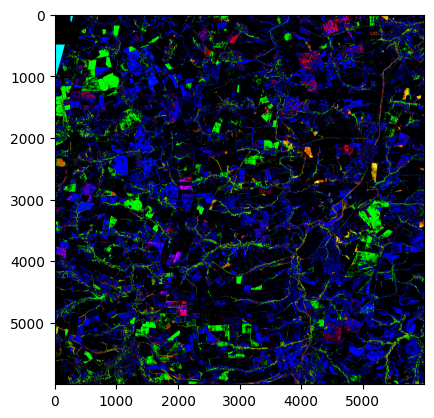

In [117]:
# Наложение маски на изображение
masked_image = cv2.bitwise_and(base_values.astype(np.uint8), normalized_blurred_mask.astype(np.uint8))
imshow(masked_image, 'r, g, b')

(array([1.1054461e+08, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 0.0000000e+00,
        0.0000000e+00, 3.3455390e+07]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

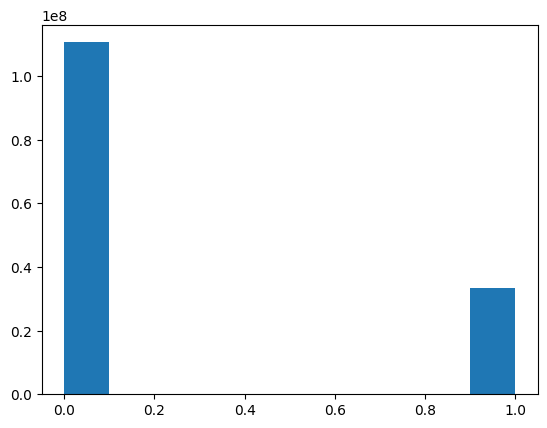

In [120]:
plt.hist(masked_image.ravel())

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\1411060985.py:36: RuntimeWarning: invalid value encountered in cast
  channel = channel.astype(np.uint8)


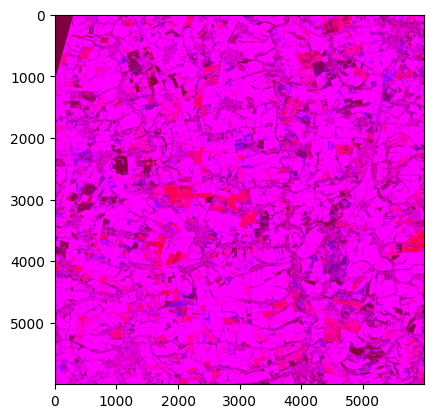

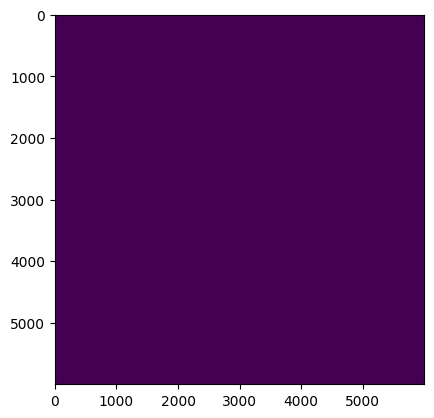

In [118]:
# Загрузка изображения
image = masked_image

# Убедиться, что изображение загружено и имеет 4 канала
if image is None or image.shape[2] != 4:
    raise ValueError("Image could not be loaded or does not have 4 channels.")

# Список значений для фильтрации (предполагается, что они даны)
values_list = [pin_points[1], values_dict[15]]#, values_dict[0], values_dict[1]]#, values_dict[2], values_dict[18], values_dict[20], values_dict[4], values_dict[5], values_dict[6], values_dict[7], values_dict[8], values_dict[9], values_dict[10]]

# Создание масок для каждого значения
masks = []
for value in values_list:
    mask = cv2.inRange(image, np.array(value), np.array(value))
    masks.append(mask)

# Создание итоговой маски
final_mask = np.zeros_like(masks[0])

# Радиус поиска для определения соседства
radius = 20
kernel_size = 2 * radius + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)

# Итеративное нахождение границ между областями
for i in range(len(masks) - 1):
    for j in range(i + 1, len(masks)):
        mask1 = masks[i]
        mask2 = masks[j]
        
        # Расширение областей первой маски
        dilated_mask1 = cv2.dilate(mask1, kernel)
        
        # Пересечение расширенных областей первой маски со второй маской
        intersection = cv2.bitwise_and(dilated_mask1, mask2)
        
        # Добавление пересечения в итоговую маску
        final_mask = cv2.bitwise_or(final_mask, intersection)


imshow(base_values, 'r, g, b')
plt.imshow(final_mask)
# # Отображение результатов
# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGRA2RGBA))
# plt.title('Original Image')
# plt.axis('off')

# plt.subplot(1, 2, 2)
# plt.imshow(final_mask, cmap='gray')
# plt.title('Final Mask with Adjacent Regions')
# plt.axis('off')

plt.show()


(array([       0.,        0.,        0.,        0.,        0., 36000000.,
               0.,        0.,        0.,        0.]),
 array([-0.5, -0.4, -0.3, -0.2, -0.1,  0. ,  0.1,  0.2,  0.3,  0.4,  0.5]),
 <BarContainer object of 10 artists>)

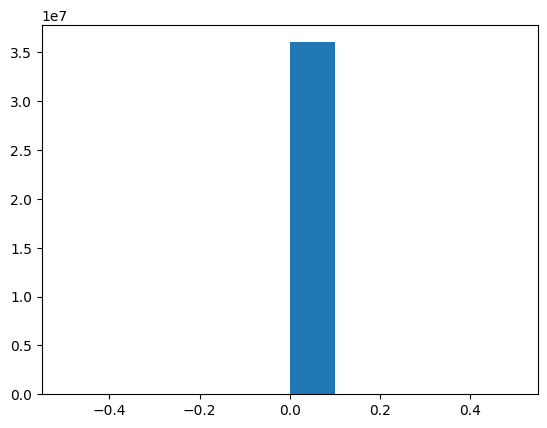

In [114]:
plt.hist(final_mask.ravel())

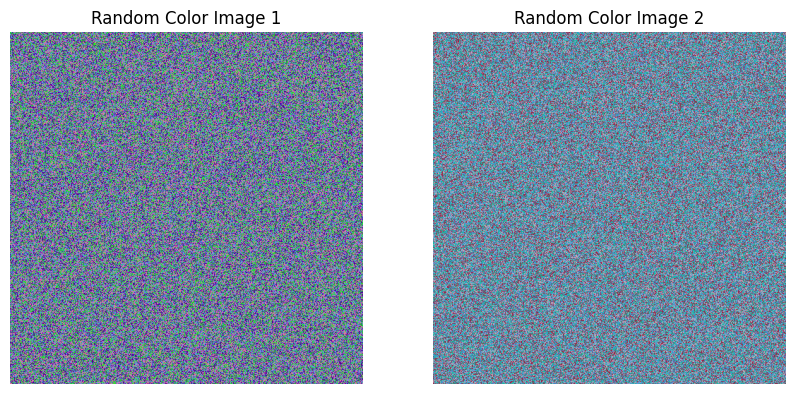

In [75]:

# Функция для создания изображения с 4 случайными цветами
def create_random_color_image(size, num_colors):
    # Генерация случайных цветов
    colors = np.random.randint(0, 256, size=(num_colors, 3), dtype=np.uint8)
    # Создание пустого изображения
    image = np.zeros((size, size, 3), dtype=np.uint8)
    # Заполнение изображения случайными цветами
    for i in range(size):
        for j in range(size):
            image[i, j] = colors[np.random.choice(num_colors)]
    return image

# Параметры изображения
size = 500
num_colors = 4

# Создание двух изображений
image1 = create_random_color_image(size, num_colors)
image2 = create_random_color_image(size, num_colors)


# Отображение изображений
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.title('Random Color Image 1')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.title('Random Color Image 2')
plt.axis('off')

plt.show()



Color (42, 223, 33) is adjacent to colors: {(165, 118, 223), (230, 146, 88), (154, 0, 81)}
Color (154, 0, 81) is adjacent to colors: {(42, 223, 33), (165, 118, 223), (230, 146, 88)}
Color (165, 118, 223) is adjacent to colors: {(42, 223, 33), (230, 146, 88), (154, 0, 81)}
Color (230, 146, 88) is adjacent to colors: {(42, 223, 33), (165, 118, 223), (154, 0, 81)}


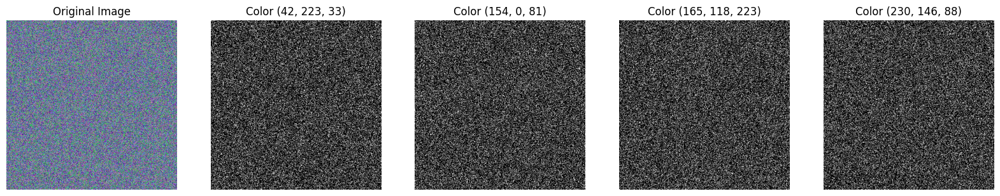

In [76]:
# Загрузка изображения


image  = image1
# Определение уникальных цветов в изображении
unique_colors = np.unique(image.reshape(-1, image.shape[2]), axis=0)

# Создание масок для каждого цвета
masks = {}
for color in unique_colors:
    masks[tuple(color)] = cv2.inRange(image, color, color)

# Радиус поиска для определения соседства
radius = 1
kernel_size = 2 * radius + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)

# Расширение областей каждого цвета и проверка пересечений
neighbors = {tuple(color): set() for color in unique_colors}
for color, mask in masks.items():
    dilated_mask = cv2.dilate(mask, kernel)
    for other_color, other_mask in masks.items():
        if color == other_color:
            continue
        intersection = cv2.bitwise_and(dilated_mask, other_mask)
        if np.any(intersection):
            neighbors[color].add(other_color)

# Вывод результатов
for color, adjacent_colors in neighbors.items():
    print(f"Color {color} is adjacent to colors: {adjacent_colors}")

# Визуализация масок для каждого цвета
fig, axes = plt.subplots(1, 5, figsize=(20, 5))
axes[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGRA2RGBA))
axes[0].set_title('Original Image')
axes[0].axis('off')

for ax, (color, mask) in zip(axes[1:], masks.items()):
    ax.imshow(mask, cmap='gray')
    ax.set_title(f'Color {color}')
    ax.axis('off')

plt.show()


ValueError: Image could not be loaded or does not have 4 channels.

In [179]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread

# Загрузка изображения-маски

mask_image = base.NDVI_mask

# Если изображение загружено как RGB, преобразовать его в одноканальное
if len(mask_image.shape) == 3:
    mask_image = cv2.cvtColor(mask_image, cv2.COLOR_RGB2GRAY)

# Уникальные классы в маске
classes = np.unique(mask_image)

# Создание структуры данных для хранения граничных областей
border_map = {cls: set() for cls in classes}

# Найти границы каждого класса
for cls in classes:
    class_mask = (mask_image == cls).astype(np.uint8)
    contours, _ = cv2.findContours(class_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Создать пустую маску для расширенных контуров
    border_mask = np.zeros_like(mask_image)
    
    # Рисовать контуры и расширять их
    cv2.drawContours(border_mask, contours, -1, 1, thickness=cv2.FILLED)
    dilated_border_mask = cv2.dilate(border_mask, np.ones((3, 3), np.uint8))
    
    # Найти пересечения с другими классами
    for other_cls in classes:
        if other_cls == cls:
            continue
        other_class_mask = (mask_image == other_cls).astype(np.uint8)
        intersection = cv2.bitwise_and(dilated_border_mask, other_class_mask)
        
        if np.any(intersection):
            border_map[cls].add(other_cls)

# Отображение границ между классами
for cls in border_map:
    print(f"Class {cls} borders with classes: {border_map[cls]}")


[2. 3. 1. 1.]
[2. 3. 1. 1.]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.0..3.0].


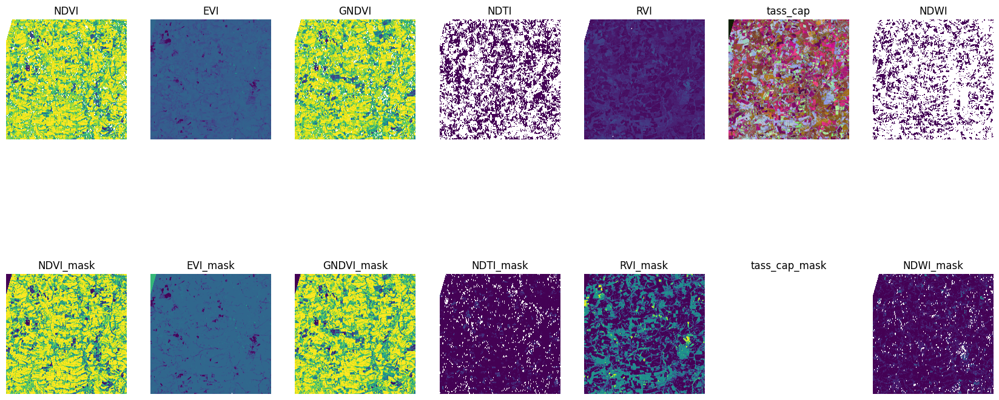

In [170]:
tass_cap_plot = normalized_filtered(base.tass_cap, 'r, g, b')
images_plot = [base.NDVI, base.EVI, base.GNDVI, base.NDTI,  base.RVI, tass_cap_plot, base.NDWI,
               base.NDVI_mask, base.EVI_mask, base.GNDVI_mask, base.NDTI_mask, base.RVI_mask, base.tass_cap_mask[:, :, :-1], base.NDWI_mask]
titles_plot = ['NDVI', 'EVI', 'GNDVI', 'NDTI', 'RVI', 'tass_cap', 'NDWI',
               'NDVI_mask', 'EVI_mask', 'GNDVI_mask', 'NDTI_mask', 'RVI_mask', 'tass_cap_mask', 'NDWI_mask']

fig = plt.figure(figsize=(21, 10))

# Создаем 3 ряда и 2 колонки субфигуров
for i in range(2):
    for j in range(7):
        # Создаем субфигур и индексируем его как i*3+j+1
        subfig = fig.add_subplot(2, 7, i*7+j+1)
        # Загружаем изображение и отображаем его в субфигуре
        subfig.imshow(images_plot[i*7+j])
        # Убираем все оси, кроме главной
        subfig.set_axis_off()
        subfig.set_title(f'{titles_plot[i*7+j]}')

In [70]:
target_value = 1

# Радиус поиска
radius = 200 

# Создать маску для пикселей с искомым значением в любом из каналов
mask = np.any(base.EVI_mask == target_value).astype(np.uint8)


# Создать квадратное ядро
kernel_size = radius + 1
kernel = np.ones((kernel_size, kernel_size), np.uint8)

# Применить свёртку
convolution_result = cv2.filter2D(mask, -1, kernel)

# Получить маску пикселей, у которых в радиусе есть пиксели с искомым значением
result_mask = (convolution_result > 0).astype(np.uint8)

# Отображение результата
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGRA2RGBA))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(result_mask, cmap='gray')
plt.title('Pixels with target value in radius')
plt.axis('off')


1


error: OpenCV(4.10.0) :-1: error: (-5:Bad argument) in function 'filter2D'
> Overload resolution failed:
>  - src is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'src'


## Поиск по EVI маскам с ORB

In [63]:
# Re-load the images using the correct file IDs

image1 = 255*image_scene.EVI_mask/np.max(image_scene.EVI_mask).astype(np.uint8)
image2= 255*base.EVI_mask[500:, 500:]/np.max(base.EVI_mask[500:, 500:]).astype(np.uint8)
image2 = np.nan_to_num(image2)

if image1 is None or image2 is None:
    raise ValueError("One or both images could not be loaded.")

# Инициализация ORB детектора
orb = cv2.ORB_create()

# Обнаружение ключевых точек и вычисление дескрипторов
keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

# Проверка, были ли вычислены дескрипторы
if descriptors1 is None or descriptors2 is None:
    print("Descriptors could not be computed for one or both images.")
    
    # Применение CLAHE для улучшения контраста изображений
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced_image1 = clahe.apply(image1)
    enhanced_image2 = clahe.apply(image2)
    
    # Повторное вычисление дескрипторов
    keypoints1, descriptors1 = orb.detectAndCompute(enhanced_image1, None)
    keypoints2, descriptors2 = orb.detectAndCompute(enhanced_image2, None)
    
    if descriptors1 is None or descriptors2 is None:
        raise ValueError("Descriptors could not be computed even after enhancing the images.")
else:
    print("Descriptors computed successfully.")

# Проверка дескрипторов на наличие недопустимых значений
if np.any(np.isnan(descriptors1)) or np.any(np.isnan(descriptors2)):
    raise ValueError("Descriptors contain NaN values.")

if np.any(np.isinf(descriptors1)) or np.any(np.isinf(descriptors2)):
    raise ValueError("Descriptors contain infinite values.")

# Убедиться, что дескрипторы имеют правильные типы и размеры
print("Descriptors1 shape:", descriptors1.shape, "dtype:", descriptors1.dtype)
print("Descriptors2 shape:", descriptors2.shape, "dtype:", descriptors2.dtype)

# Инициализация BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# Сопоставление дескрипторов
matches = bf.match(descriptors1, descriptors2)

# Сортировка совпадений по расстоянию
matches = sorted(matches, key=lambda x: x.distance)

# Использование совпадений для нахождения матрицы гомографии
if len(matches) >= 10:
    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

    # Преобразование второго изображения для выравнивания с первым
    height, width = image1.shape
    aligned_image = cv2.warpPerspective(image2, H, (width, height))

    # Комбинирование изображений для визуализации выравнивания
    combined_image = cv2.addWeighted(image1, 0.5, aligned_image, 0.5, 0)

    # Отображение комбинированного изображения
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(combined_image, cv2.COLOR_GRAY2RGB))
    plt.title('Combined Image')
    plt.axis('off')
    plt.show()
else:
    print("Not enough matches found to compute homography.")


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\2959124330.py:4: RuntimeWarning: invalid value encountered in cast
  image2= 255*base.EVI_mask[500:, 500:]/np.max(base.EVI_mask[500:, 500:]).astype(np.uint8)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_4276\2959124330.py:4: RuntimeWarning: divide by zero encountered in divide
  image2= 255*base.EVI_mask[500:, 500:]/np.max(base.EVI_mask[500:, 500:]).astype(np.uint8)


error: OpenCV(4.10.0) d:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\color.simd_helpers.hpp:92: error: (-2:Unspecified error) in function '__cdecl cv::impl::`anonymous-namespace'::CvtHelper<struct cv::impl::`anonymous namespace'::Set<3,4,-1>,struct cv::impl::A0x57e76b25::Set<1,-1,-1>,struct cv::impl::A0x57e76b25::Set<0,2,5>,4>::CvtHelper(const class cv::_InputArray &,const class cv::_OutputArray &,int)'
> Invalid number of channels in input image:
>     'VScn::contains(scn)'
> where
>     'scn' is 1


In [60]:
descriptors2

## Ищем ближайших соседей

In [34]:
def cut_image_into_parts(image, h, w, scale_factor):
    h = scale_factor*h
    w = scale_factor*w
    #scale_factor = 8
    #scaled_image = rescale(image, scale_factor, anti_aliasing=True, multichannel=True)
    

    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    index = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            #part = normalized_filtered(part, 'nir, g, b', True)
            part = Scene(part, 1)
            #part = calcus_RVI(part[:, :, 0], part[:, :, 3], True)
            part = part.NDVI_mask

            plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/base_false_color_masks/'  + str(index) + r".png", part, cmap='gray', dpi=300)
            index +=1
            #plt.show()
            # Append the part to the list
            parts.append(part)
    
    return parts



def calculate_parts_coordinates(image, h, w, scale_factor):
    h = scale_factor*h
    w = scale_factor*w
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    index = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            parts.append([index, start_row, end_row, start_col, end_col])
            index+=1
    return parts


def zooming(image, scale_factor):
    # Zoom out the image
    zoomed_image = rescale(image, scale_factor, anti_aliasing=True) #, channel_axis=-1)
    return zoomed_image

In [38]:
# Пример целевого изображения и набора данных (np.array)
# fasle color не ищет
#target = normalized_filtered(crop_scenes[3].img, 'nir, g, b', True)
# без уравнивания гистограммы тоже
#target = normalized_filtered(crop_scenes[3].img, 'nir, g, b')
#target = crop_scenes[3].RVI_mask
target = crop_scenes[1].NDVI_mask
target = zooming(target, 5)
back_map = bases[0][:, :6000, :]


h, w = target.shape
scale_factor = 1
base_masks = cut_image_into_parts(back_map, h, w, scale_factor)
base_set_coordinates = calculate_parts_coordinates(back_map, h, w, scale_factor)

dataset = np.array(base_masks)


# # Преобразуем каждое изображение в одномерный массив
target_flat = target.flatten()
dataset_flat = dataset.reshape((dataset.shape[0], -1))

# Создаем и обучаем модель NearestNeighbors
nbrs = NearestNeighbors(n_neighbors=3, algorithm='brute').fit(dataset_flat)

# Поиск ближайшего соседа для целевого изображения
distances, indices = nbrs.kneighbors([target_flat])

# Получение индекса и самого похожего изображения
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"Наиболее похожее изображение находится по индексу {most_similar_image_index}")

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:16: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:29: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:29: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:49: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_

Наиболее похожее изображение находится по индексу 20


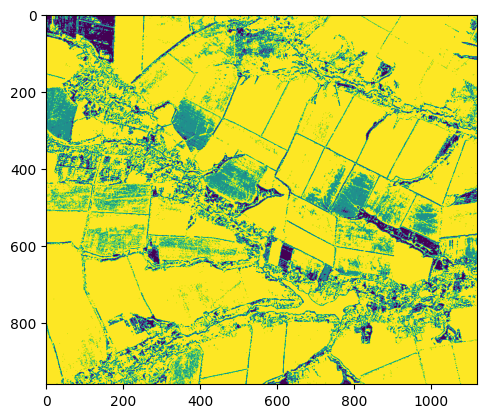

In [39]:
plt.imshow(most_similar_image)

[[20 27  5]]


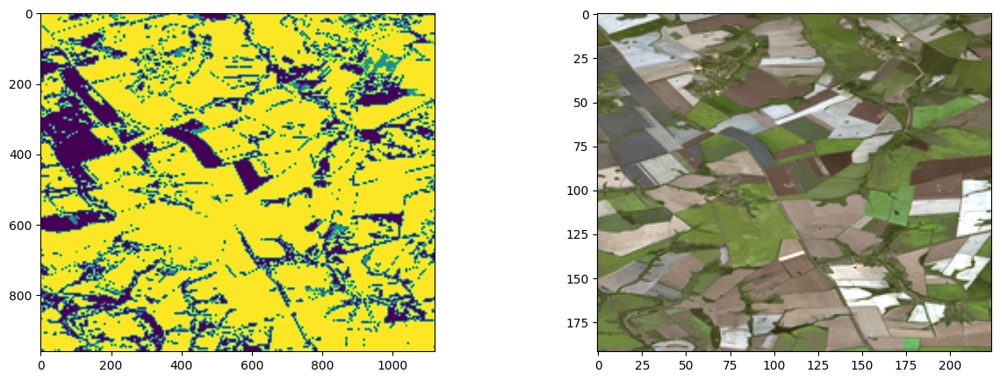

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


(-0.5, 1619.5, 1459.5, -0.5)

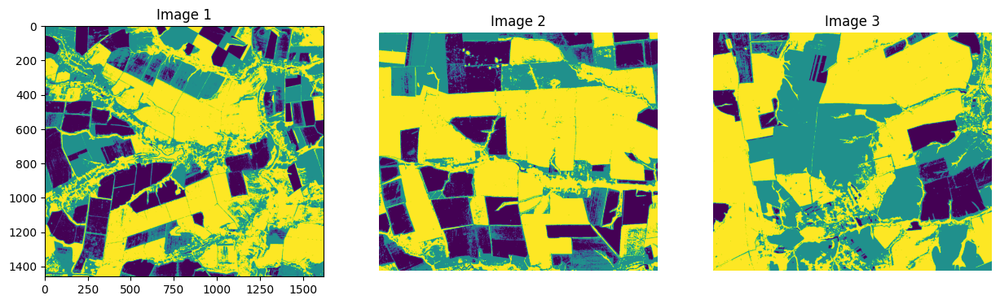

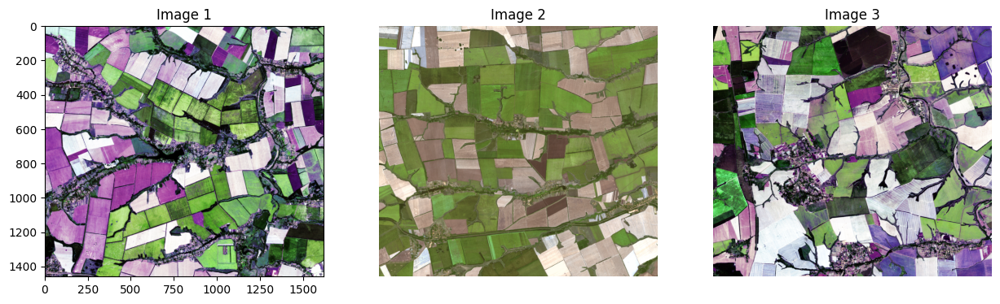

In [41]:
print(indices)
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].imshow(target)
axes[1].imshow(normalized_filtered(crop_scenes[1].img, 'r, g, b'))


plt.show()

start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][0]][1:5]
image1 = calcus_NDVI(bases[0][start_row:end_row+500, start_col:end_col+500, 0], bases[0][start_row:end_row+500, start_col:end_col+500, 3], True)
start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][1]][1:5]
image2 = calcus_NDVI(bases[0][start_row:end_row, start_col:end_col, 0], bases[0][start_row:end_row, start_col:end_col, 3], True)
start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][2]][1:5]
image3 = calcus_NDVI(bases[0][start_row:end_row, start_col:end_col, 0], bases[0][start_row:end_row, start_col:end_col, 3], True)

# Create a figure with a row of 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display each image in a subplot
axes[0].imshow(image1)
axes[0].set_title('Image 1')
#axes[0].axis('off')  # Hide axes for better visualization

axes[1].imshow(image2)
axes[1].set_title('Image 2')
axes[1].axis('off')

axes[2].imshow(image3)
axes[2].set_title('Image 3')
axes[2].axis('off')

start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][0]][1:5]
image1 = normalized_filtered(bases[0][start_row:end_row+500, start_col:end_col+500,:], 'r, g, b', True)
start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][1]][1:5]
image2 = normalized_filtered(bases[0][start_row:end_row+500, start_col:end_col+500,:], 'r, g, b')
start_row, end_row, start_col, end_col = base_set_coordinates[indices[0][2]][1:5]
image3 = normalized_filtered(bases[0][start_row:end_row+500, start_col:end_col+500,:], 'r, g, b', True)

# Create a figure with a row of 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display each image in a subplot
axes[0].imshow(image1)
axes[0].set_title('Image 1')
#axes[0].axis('off')  # Hide axes for better visualization

axes[1].imshow(image2)
axes[1].set_title('Image 2')
axes[1].axis('off')

axes[2].imshow(image3)
axes[2].set_title('Image 3')
axes[2].axis('off')

## Насколько маски вообще похожи

In [42]:
base_scenes = Scene(bases[0][:6000, :6000, :],1)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:16: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:29: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:29: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:49: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_

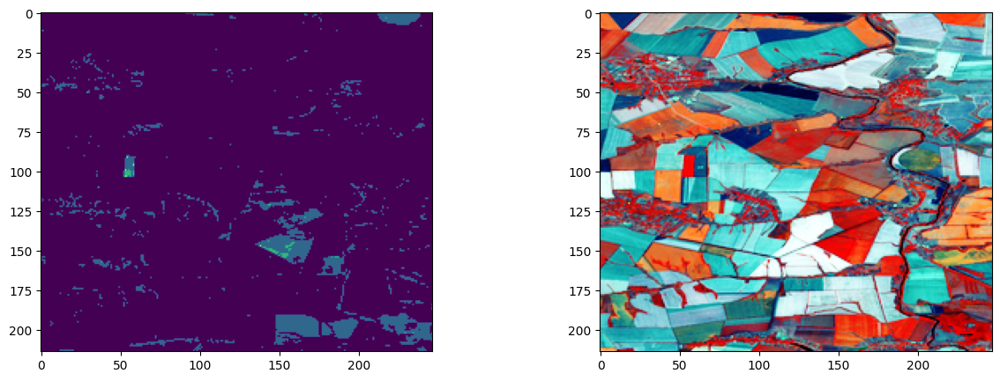

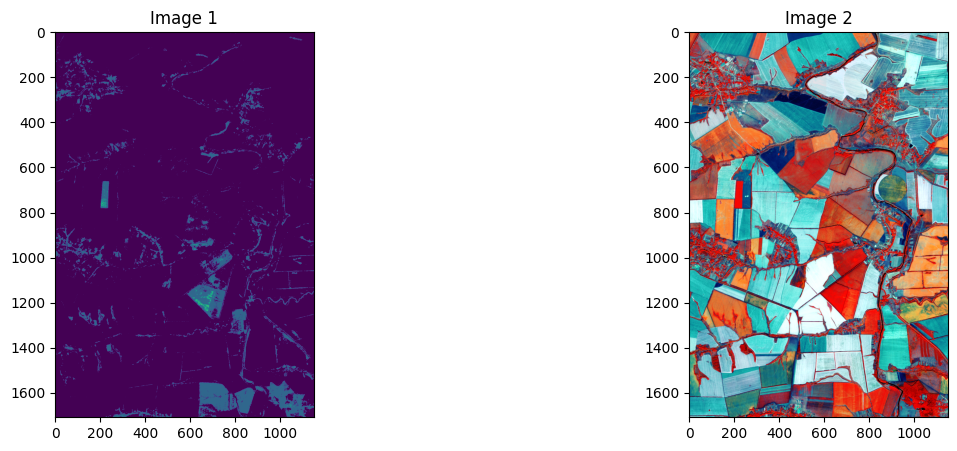

In [182]:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
scn = 2
axes[0].imshow(crop_scenes[scn].RVI_mask)
axes[1].imshow(normalized_filtered(crop_scenes[scn].img, 'nir, g, b', True))
plt.show()

# для сцены 0 [270, 2200, 250, 1400]
# для сцены 1 [550, 2200, 1400, 2600]
# для сцены 2 [490, 2200, 2750, 3900]
start_row, end_row, start_col, end_col = [490, 2200, 2750, 3900]
image1 = base_scenes.RVI_mask[start_row:end_row, start_col:end_col]
image2 = normalized_filtered(base_scenes.img[start_row:end_row, start_col:end_col], 'nir, g, b', True)


# Create a figure with a row of 3 subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Display each image in a subplot
axes[0].imshow(image1)
axes[0].set_title('Image 1')
#axes[0].axis('off')  # Hide axes for better visualization

axes[1].imshow(image2)
axes[1].set_title('Image 2')
#axes[1].axis('off')

plt.show()


In [138]:
def picture_fingerprint(image):
    plt.imshow(image)
    plt.show()
    kernel = np.array([[-1/9,-1/9,-1/9], [-1/9, 17/9,-1/9], [-1/9,-1/9,-1/9]])
    gray = cv2.filter2D(image, -1, kernel*3)
    edged = cv2.Canny(image, 30, 200) 
    contours, hierarchy = cv2.findContours(edged.copy(),  
        cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
    #im = calcus_NDVI(img.r, img.nir)
    contoured = cv2.drawContours(image, contours, -1, (255, 0, 1), 1)
    #gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    mask = np.zeros_like(gray)
    # Заполнение найденных контуров белым цветом
    cv2.drawContours(mask, contours, -1, 255, thickness=cv2.FILLED)

    # Применение маски к изображению для удаления всего за пределами контура
    masked_image = cv2.bitwise_and(gray, gray, mask=mask)


    kernel = np.ones((3, 3), np.uint8)
    closed_image = cv2.morphologyEx(masked_image, cv2.MORPH_CLOSE, kernel, iterations=1)
    opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel, iterations=2)

    masked_image_2 = cv2.bitwise_and(image, image, mask=opened_image)



    # Отображение оригинального и обработанного изображений
    plt.figure(figsize=(15, 10))

    plt.subplot(1, 5, 1)
    plt.imshow(image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.imshow(masked_image)
    plt.title('Masked Image')
    plt.axis('off')


    plt.subplot(1, 5, 3)
    plt.imshow(closed_image)
    plt.title('Closed Image')
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.imshow(opened_image)
    plt.title('Opened Image')
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.imshow(masked_image_2)
    plt.title('Masked Image 2')
    plt.axis('off')
    plt.show()

In [189]:
gray.astype(np.uint8)

array([[191, 191, 191, ..., 191, 191, 191],
       [191, 191, 191, ..., 191, 191, 191],
       [191, 191, 191, ..., 191, 191, 191],
       ...,
       [191, 191, 191, ..., 191, 191, 191],
       [191, 191, 191, ..., 191, 191, 191],
       [191, 191, 191, ..., 191, 191, 191]], dtype=uint8)

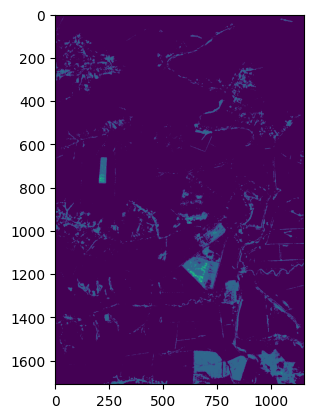

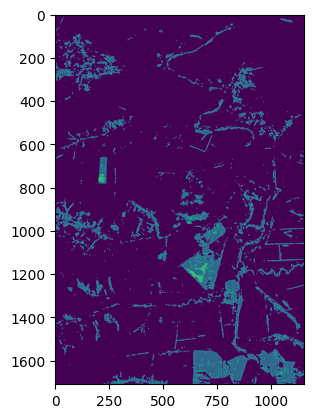

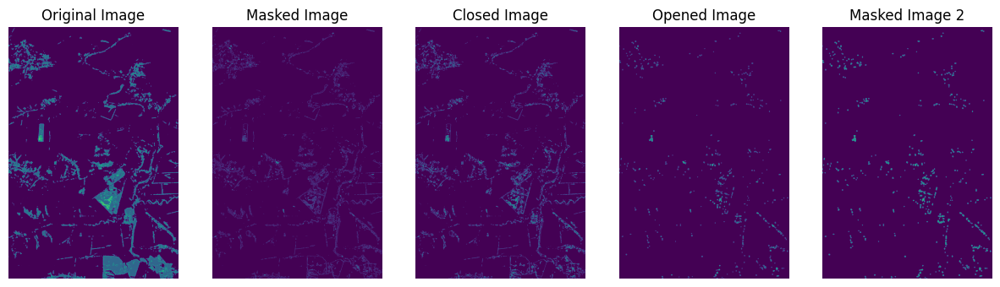

In [197]:
#image = normalized_filtered(crop_scenes[scn].img, 'nir, g, b')
scn = 2
image = base_scenes.RVI_mask[start_row:end_row, start_col:end_col].copy()
image = 255*image/np.max(image).astype(np.uint8)
#image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
plt.imshow(image)
plt.show()
#kernel = np.array([[-1/9,-1/9,-1/9], [-1/9, 17/9,-1/9], [-1/9,-1/9,-1/9]])
#gray = cv2.filter2D(image, -1, kernel*3).astype(np.uint8)
gray = image.astype(np.uint8)
#plt.imshow(gray)
#plt.show()
image = image.astype(np.uint8)
edged = cv2.Canny(image.astype(np.uint8), 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
#im = calcus_NDVI(img.r, img.nir)
contoured = cv2.drawContours(image, contours, -1, (255, 0, 1), 1)
plt.imshow(contoured)
plt.show()
#gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
mask = np.zeros_like(gray)
# Заполнение найденных контуров белым цветом
cv2.drawContours(mask, contours, -1, 255, thickness=cv2.FILLED)

# Применение маски к изображению для удаления всего за пределами контура
masked_image = cv2.bitwise_and(gray, gray, mask=mask)


kernel = np.ones((3, 3), np.uint8)
closed_image = cv2.morphologyEx(masked_image, cv2.MORPH_CLOSE, kernel, iterations=1)
opened_image = cv2.morphologyEx(closed_image, cv2.MORPH_OPEN, kernel, iterations=2)

masked_image_2 = cv2.bitwise_and(image, image, mask=opened_image)



# Отображение оригинального и обработанного изображений
plt.figure(figsize=(15, 10))

plt.subplot(1, 5, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 5, 2)
plt.imshow(masked_image)
plt.title('Masked Image')
plt.axis('off')


plt.subplot(1, 5, 3)
plt.imshow(closed_image)
plt.title('Closed Image')
plt.axis('off')

plt.subplot(1, 5, 4)
plt.imshow(opened_image)
plt.title('Opened Image')
plt.axis('off')

plt.subplot(1, 5, 5)
plt.imshow(masked_image_2)
plt.title('Masked Image 2')
plt.axis('off')


plt.show()

## Маски города

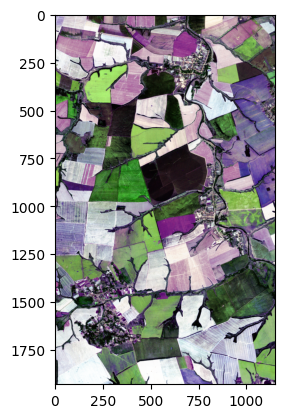

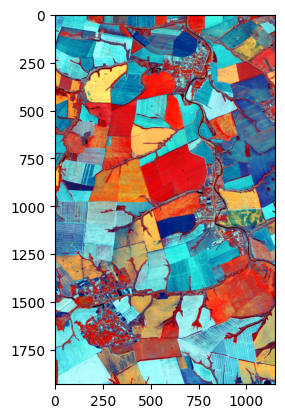

(1930, 1150, 3)


C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_26168\672786038.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)


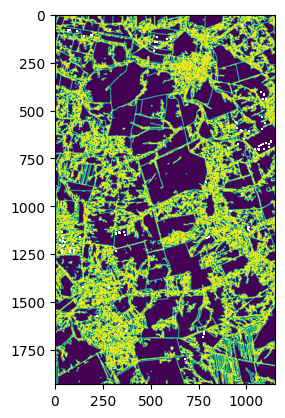

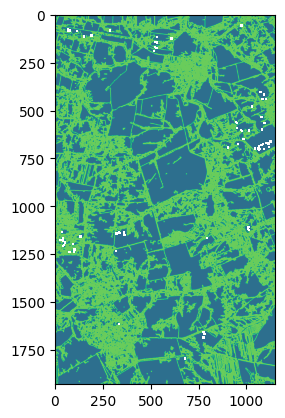

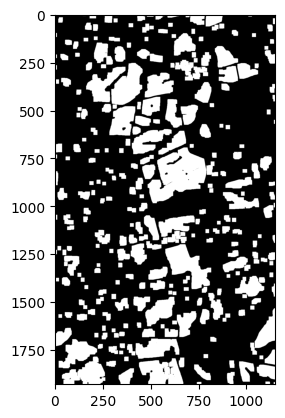

In [147]:
scn = 5
image = crop_scenes[scn]

start_row, end_row, start_col, end_col = [270, 2200, 250, 1400]
image = Scene(base_scenes[]

ch_channels = 'nir, g, b'
imshow(image.img[start_row:end_row, start_col:end_col], 'r, g, b', True)
imshow(image.img[start_row:end_row, start_col:end_col], ch_channels, True)
#plt.imshow(calcus_NDVI(img.r, img.nir, True))
#plt.show()
im = normalized_filtered(image.img[start_row:end_row, start_col:end_col], ch_channels, True)#[:100, :100, :]
#im = calcus_NDVI(img.r, img.nir)
print(im.shape)
gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY) 
edged = cv2.Canny(gray, 30, 200) 
contours, hierarchy = cv2.findContours(edged.copy(),  
    cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
im = calcus_NDVI(image.r[start_row:end_row, start_col:end_col], image.nir[start_row:end_row, start_col:end_col])
plt.imshow(cv2.drawContours(im, contours, -1, (255, 1, 1), 2))
contoured = cv2.drawContours(im, contours, -1, (255, 0, 1), 4)
plt.show()
kernel = np.array([[-1/9,-1/9,-1/9], [-1/9, 17/9,-1/9], [-1/9,-1/9,-1/9]])
#Laplacian operator, sharpening filter L/
#kernel = np.array([[-0,-1/4,0], [-1/4, 2,-1/4], [0,-1/4,0]])
sharpened_image = cv2.filter2D(contoured, -1, kernel)
plt.imshow(sharpened_image)
plt.show()
#opening
#sharpened_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)

binr = cv2.threshold(sharpened_image, 0, 255, 
                     cv2.THRESH_BINARY)[1] 
  
# define the kernel 
kernel = np.ones((3, 3), np.uint8) 
  
# opening the image 
opening = cv2.morphologyEx(binr,  cv2.MORPH_OPEN, 
                           kernel, iterations=9) 
# print the output 
plt.imshow(opening, cmap='gray') 

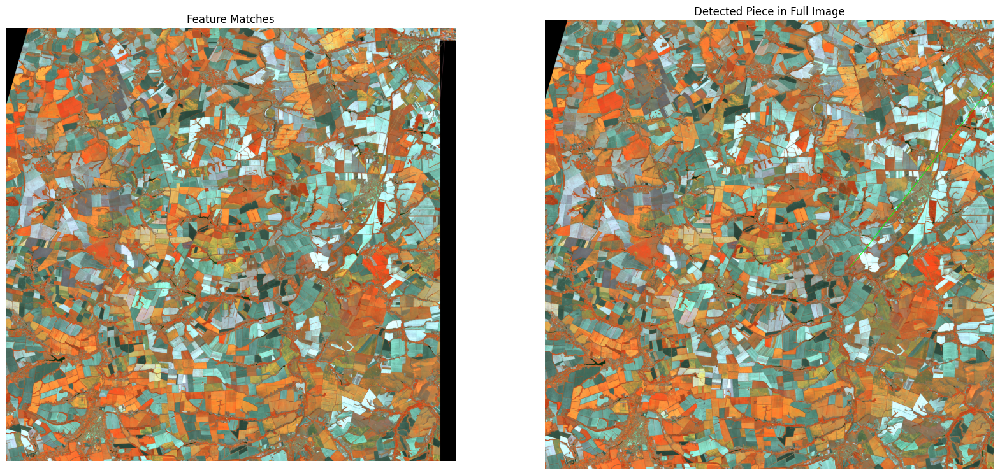

In [149]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread

# Load images
full_image  = normalized_filtered(base_scenes.img, 'nir, g, b')
piece_image = normalized_filtered(crop_scenes[scn].img, 'nir, g, b')


# Convert images to grayscale
full_gray = cv2.cvtColor(full_image, cv2.COLOR_RGB2GRAY)
piece_gray = cv2.cvtColor(piece_image, cv2.COLOR_RGB2GRAY)

# Initialize ORB detector
orb = cv2.ORB_create()

# Detect keypoints and descriptors
keypoints1, descriptors1 = orb.detectAndCompute(full_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(piece_gray, None)

# Initialize BFMatcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# Match descriptors
matches = bf.match(descriptors1, descriptors2)

# Sort matches by distance
matches = sorted(matches, key=lambda x: x.distance)

# Draw top matches
img_matches = cv2.drawMatches(full_image, keypoints1, piece_image, keypoints2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Find homography if enough matches are found
if len(matches) >= 10:
    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

    h, w, _ = piece_image.shape
    pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
    dst = cv2.perspectiveTransform(pts, H)

    full_image_with_box = cv2.polylines(full_image.copy(), [np.int32(dst)], True, (0, 255, 0), 250, cv2.LINE_AA)

    # Display results
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(img_matches)
    plt.title('Feature Matches')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(full_image_with_box)
    plt.title('Detected Piece in Full Image')
    plt.axis('off')

    plt.show()
else:
    print("Not enough matches found to determine if the piece is part of the full image.")


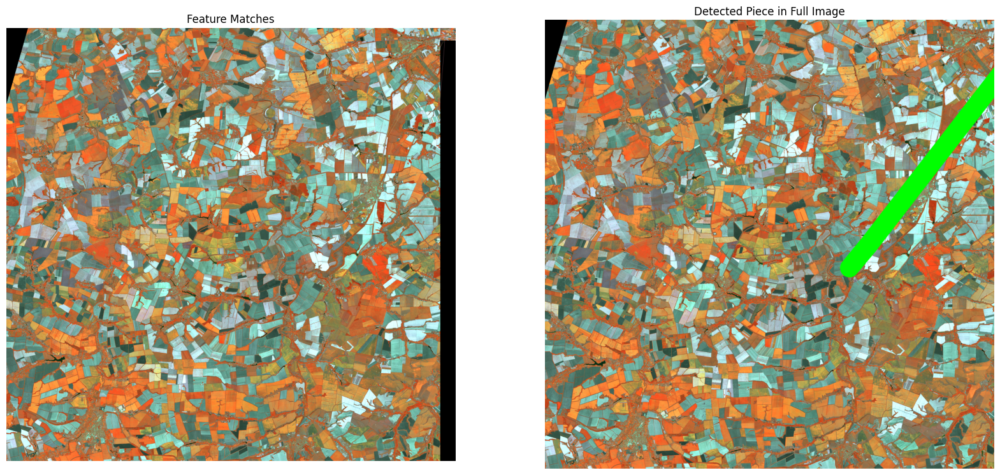

In [152]:
if True:
    full_image_with_box = cv2.polylines(full_image.copy(), [np.int32(dst)], True, (0, 255, 0), 250, cv2.LINE_AA)

    # Display results
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(img_matches)
    plt.title('Feature Matches')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(full_image_with_box)
    plt.title('Detected Piece in Full Image')
    plt.axis('off')

    plt.show()


## Ищем ближайших соседей по наполняемости классов   
Мы масштаб не знаем, тут ввожу его руками

In [81]:
def cut_image_into_parts(image, h, w, scale_factor):
    h = scale_factor*h
    w = scale_factor*w
    #scale_factor = 8
    #scaled_image = rescale(image, scale_factor, anti_aliasing=True, multichannel=True)
    

    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    j = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            
            back_scene = Scene(part, 1)
            part = back_scene.mask_list
            #plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/base_false_color_masks/'  + str(j) + r".png", part, cmap='gray', dpi=300)
            #plt.show()
            # Append the part to the list
            parts.append(part)
    
    return parts

In [82]:
def calculate_parts_coordinates(image, h, w, scale_factor):
    h = scale_factor*h
    w = scale_factor*w
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    index = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            parts.append([index, start_row, end_row, start_col, end_col])
            index+=1
    return parts

In [83]:
crop = crop_scenes[6]
h, w = crop.img.shape[:-1]
scale_factor = 6
base_scenes = cut_image_into_parts(bases[0], h, w, scale_factor)
base_set_coordinates = calculate_parts_coordinates(bases[0], h, w, scale_factor)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:15: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:48: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipyk

In [84]:
import numpy as np
from sklearn.neighbors import NearestNeighbors

# Пример целевого изображения и набора данных (np.array)
target = sum(crop.mask_list, [])
dataset = []
for item in base_scenes:
    dataset.append(sum(item, []))

# # Преобразуем каждое изображение в одномерный массив
# target_image_flat = target_image.flatten()
# dataset_flat = dataset.reshape((dataset.shape[0], -1))

# Создаем и обучаем модель NearestNeighbors
nbrs = NearestNeighbors(n_neighbors=3, algorithm='auto').fit(dataset)

# Поиск ближайшего соседа для целевого изображения
distances, indices = nbrs.kneighbors([target])

# Получение индекса и самого похожего изображения
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"Наиболее похожее изображение находится по индексу {most_similar_image_index}")


Наиболее похожее изображение находится по индексу 37


In [85]:
indices

array([[37, 49,  1]], dtype=int64)

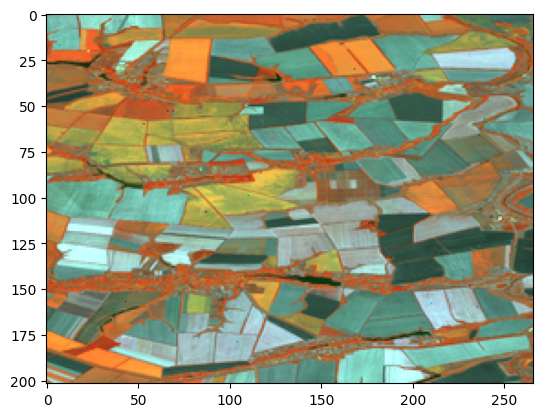

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:15: RuntimeWarning: divide by zero encountered in divide
  EVI = 2.5*((nir - r)/(nir + 6*r - 7.5*b + 1))
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeWarning: divide by zero encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:48: RuntimeWarning: divide by zero encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipyk

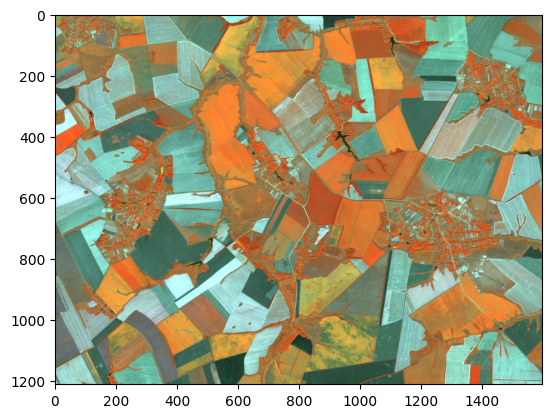

In [90]:
base_set_coordinates = calculate_parts_coordinates(bases[0], h, w, scale_factor)
base_set_coordinates
imshow(crop.img, 'nir, g, b')
best = indices[0][2]
start_row, end_row, start_col, end_col = base_set_coordinates[best][1:]
found = Scene(bases[0][start_row:end_row, start_col:end_col, :], 1)
imshow(found.img, 'nir, g, b')

## Создаём и выгружаем маски из ложных цветов

In [9]:
def false_color_crop_mask(img : Scene):
    kernel = np.ones((11, 11),np.float32)/60
    sharpened_image = cv2.filter2D(normalized_filtered(img.img, 'nir, g, b'), -1, kernel)
    
    gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray_image)
    #plt.colorbar()
    #plt.show()
    tmp = gray_image.copy()
    trh = 246
    tmp[tmp>trh] = 255
    tmp[tmp<=trh] = 0
    scale_factor = 6
    #tmp = rescale(tmp, scale_factor, anti_aliasing=True)
    #crop_scenes[i].zoomed = tmp
    return tmp

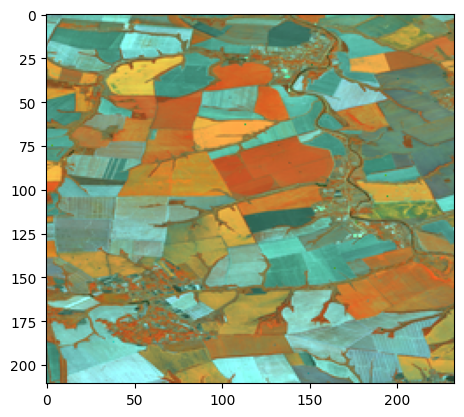

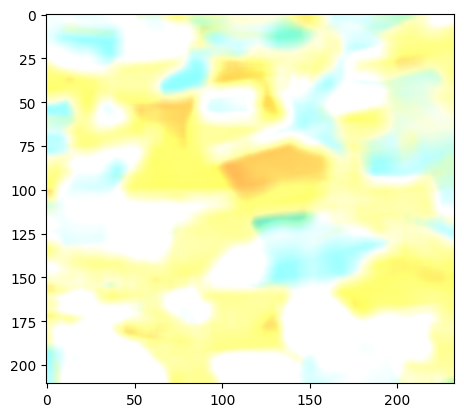

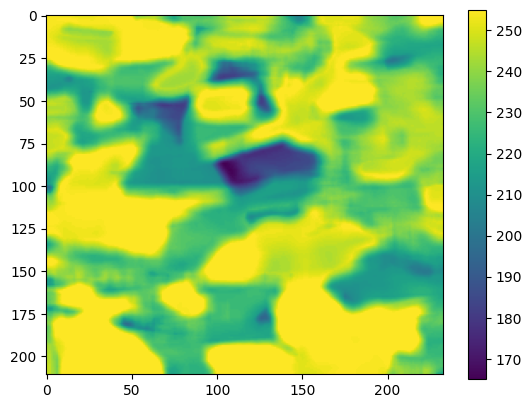

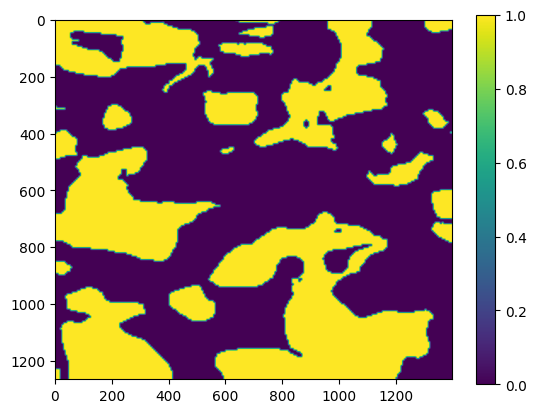

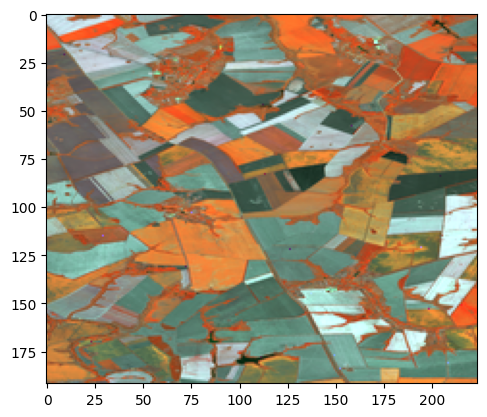

...

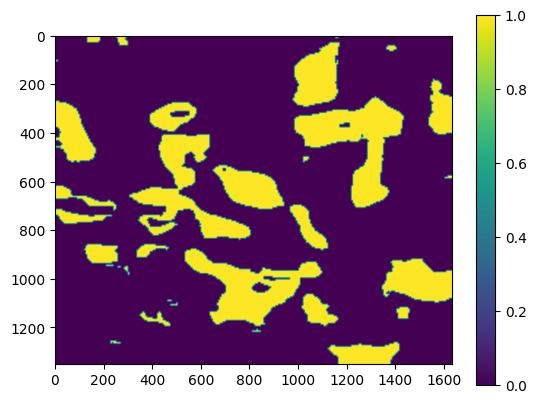

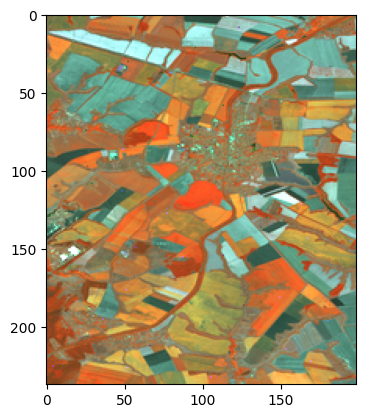

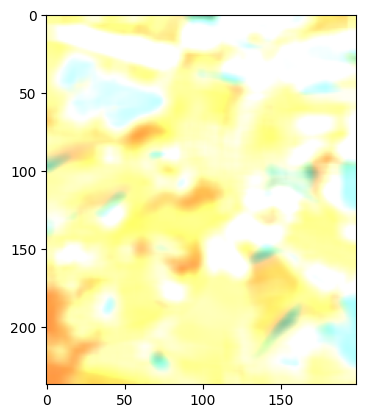

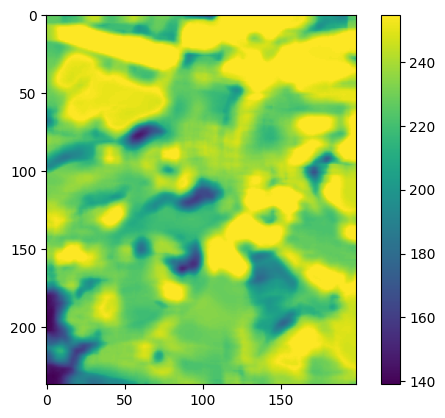

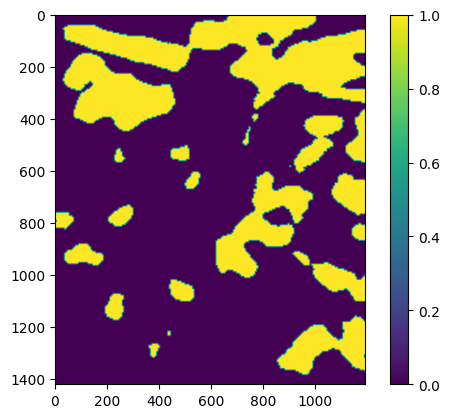

In [10]:
for i in range(19):
    #imshow(small_back.img, 'nir, g, b')
    #plt.imshow(calcus_NDVI(small_back.r, small_back.nir, True))
    #img_cont = Scene(images[i], 0)
    #img_cont = img_cont.img[300:1500, :1500, :]
    img = crop_scenes[i]
    
    kernel = np.ones((11, 11),np.float32)/55
    sharpened_image = cv2.filter2D(normalized_filtered(img.img, 'nir, g, b'), -1, kernel)
    
    gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray_image)
    #plt.colorbar()
    #plt.show()
    tmp = gray_image.copy()
    trh = 246
    tmp[tmp>trh] = 255
    tmp[tmp<=trh] = 0
    scale_factor = 6
    tmp = rescale(tmp, scale_factor, anti_aliasing=True)
    crop_scenes[i].zoomed = tmp
    #plt.imshow(tmp)
    plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/crops_false_color_masks/'  + str(i) + r".png", tmp, cmap='gray', dpi=300)
    plt.show()
    plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/crops_false_color_masks/rgb_'  + str(i) + r".png", normalized_filtered(img.img, 'nir, g, b'), cmap='gray', dpi=300)
    plt.show()
    #plt.hist(gray_image[(gray_image>230)& (gray_image<250)].ravel(), bins=256)
    imshow(img.img, 'nir, g, b')
    plt.show()
    plt.imshow(sharpened_image)
    plt.show()
    plt.imshow(gray_image)
    plt.colorbar()
    plt.show()
    plt.imshow(tmp)
    plt.colorbar()
    plt.show()

# Поиск подходящего изображения

## Нарезка подложки под искомое изображение    
Искомое изображение записывается в `chosen_crop` в виде объекта класса `Scene`  
Каждый кусочек пересчитывается в маску и сохраняется в папке `base_false_color_masks`

In [92]:
def false_color_base_mask (image):
    #imshow(small_back.img, 'nir, g, b')
    #plt.imshow(calcus_NDVI(small_back.r, small_back.nir, True))
    base_scene = Scene(image, 1)
    base_crop = base_scene.img
    #imshow(base_crop, 'nir, g, b')
    kernel = np.ones((25, 25),np.float32)/260
    sharpened_image = cv2.filter2D(normalized_filtered(base_crop, 'nir, g, b'), -1, kernel)
    #plt.imshow(sharpened_image)
    #plt.show()
    gray_image = cv2.cvtColor(sharpened_image, cv2.COLOR_BGR2GRAY)
    # Может быть добавить контраста
    #plt.imshow(gray_image)
    #plt.colorbar()
    #plt.show()
    tmp = gray_image.copy()
    trh = 246
    tmp[tmp>trh] = 255
    tmp[tmp<=trh] = 0
    #plt.imshow(tmp)
    return (tmp)

    # plt.imshow(tmp, cmap='gray')
    # plt.show()
    # plt.hist(gray_image.ravel(), bins=256)


In [11]:
# # Example image (random values for demonstration)
# image = base_masks[10]

# # Scaling factor
# scale_factor = 1/8

# # Scale the image
# scaled_image = rescale(image, scale_factor, anti_aliasing=True)

# # Display the original and scaled images for comparison
# fig, axes = plt.subplots(1, 2, figsize=(10, 5))
# axes[0].imshow(image)  # Display only the first 3 channels for visualization
# axes[0].set_title('Original Image')
# axes[1].imshow(scaled_image)  # Display only the first 3 channels for visualization
# axes[1].set_title('Scaled Image')
# plt.show()

# # Verify the new shape
# print(f"Original shape: {image.shape}")
# print(f"Scaled shape: {scaled_image.shape}")


In [93]:
def cut_image_into_parts(image, h, w):
    #scale_factor = 8
    #scaled_image = rescale(image, scale_factor, anti_aliasing=True, multichannel=True)
    

    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    index = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            
            part = false_color_base_mask(part)
            plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/base_false_color_masks/'  + str(index) + r".png", part, cmap='gray', dpi=300)
            index+=1
            plt.show()
            # Append the part to the list
            #parts.append(part)
    
    return parts

In [94]:
chosen_crop = crop_scenes[10]
chosen_crop.zoomed.shape

AttributeError: 'Scene' object has no attribute 'zoomed'

In [95]:
chosen_crop = crop_scenes[1]
#h, w = chosen_crop.zoomed.shape
cut_image_into_parts(bases[0], h, w)

C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: invalid value encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeWarning: invalid value encountered in divide
  GNDVI = (nir-g)/(nir+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:48: RuntimeWarning: invalid value encountered in divide
  NDTI = (r-g)/(r+g)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:59: RuntimeWarning: invalid value encountered in divide
  RVI = nir/r
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:99: RuntimeWarning: invalid value encountered in divide
  NDWI = (g-nir)/(g+nir)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:3: RuntimeWarning: divide by zero encountered in divide
  NDVI = (nir - r)/(nir +r)
C:\Users\Maria Smirnova\AppData\Local\Temp\ipykernel_10096\3869299719.py:28: RuntimeW

[]

## Расчет площадей классов

1.0 - 49631
2.0 - 3147
3.0 - 75
4.0 - 5
52858
52858


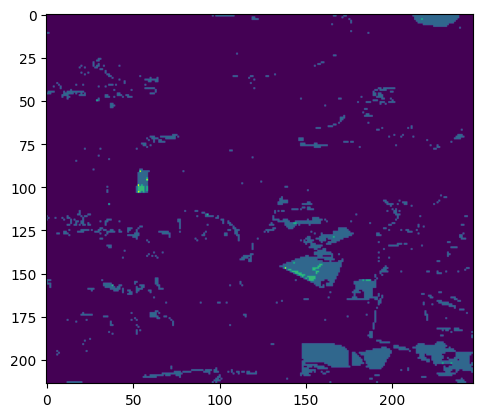

In [236]:
base = bases[0]
crop = crop_scenes[2]

plt.imshow(calcus_RVI(crop.r, crop.nir, True))

unique_values, counts = np.unique(calcus_RVI(crop.r, crop.nir, True), return_counts=True)
# Выводим результаты
sum = 0
for value, count in zip(unique_values, counts):
    print(f"{value} - {count}")
    sum += count

print(sum)
print(calcus_RVI(crop.r, crop.nir, True).shape[0]* calcus_RVI(crop.r, crop.nir, True).shape[1])

## Поиск ближайших соседей

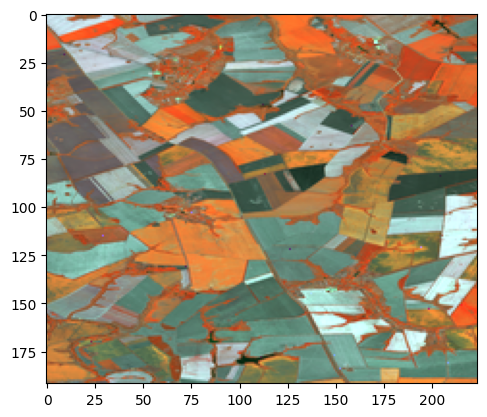

[[[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]

 [[255 255 255 255]
  [255 255 255 255]
  [255 255 255 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]

 ...

 [[  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]

 [[  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]

 [[  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]
  ...
  [  0   0   0 255]
  [  0   0   0 255]
  [  0   0   0 255]]]


In [15]:
imshow(chosen_crop.img, 'nir, g, b')
chosen_path = r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\crops_false_color_masks\1.png"

im = np.array(Image.open(chosen_path))
  
print(im)
# This method will show image in any image viewer  
#im.show()


#cv2.imread(chosen_path, cv2.IMREAD_GRAYSCALE)
#print(cv2.imread(chosen_path, cv2.IMREAD_GRAYSCALE))

In [98]:
base_path = r'C:\Users\Maria Smirnova\Desktop\Проекты\LDT\base_false_color_masks'
base_key_word = 'layout'
files_format = ['png']

base_masks = []
for address, dirs, files in os.walk(base_path):
    #print(address, dirs, files)
    for f in files:
            if f.endswith('png'):
                file_path = os.path.join(address, f)
                #print(file_path)
                im = np.array(Image.open(file_path).convert('L'))
                base_masks.append(im)

In [100]:
# Assuming target_image and dataset are given as np.arrays with shape (height, width, 6)
chosen_path = r"C:\Users\Maria Smirnova\Desktop\Проекты\LDT\crops_false_color_masks\0.png"
target_image =  np.array(Image.open(chosen_path).convert('L'))


dataset = np.array(base_masks)
# Flatten each image into a 1D array
target_image_flat = target_image.flatten()
dataset_flat = dataset.reshape((dataset.shape[0], -1))
#---------КОСТЫЛЬ----------------------
dataset_flat = np.nan_to_num(dataset_flat)
#---------КОСТЫЛЬ----------------------

# Initialize and fit the NearestNeighbors model
nbrs = NearestNeighbors(n_neighbors=4, algorithm='auto').fit(dataset_flat)

# Find the nearest neighbor to the target image
distances, indices = nbrs.kneighbors([target_image_flat])

# The most similar image
most_similar_image_index = indices[0][0]
most_similar_image = dataset[most_similar_image_index]

print(f"The most similar image is at index {most_similar_image_index}")


ValueError: X has 1769868 features, but NearestNeighbors is expecting 53732 features as input.

TypeError: unhashable type: 'numpy.ndarray'

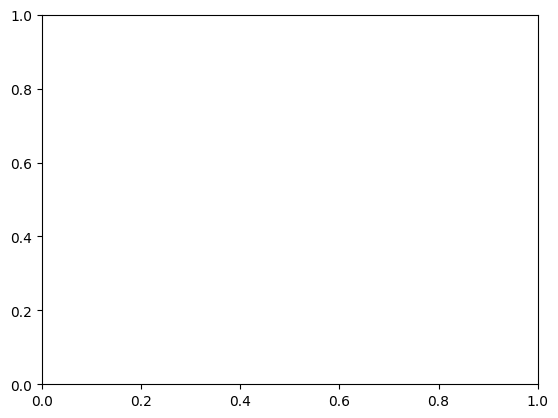

In [18]:
#for base_part in base_masks[0]:
if True:
    base_part = base_masks[2]
    # Применяем функцию адаптивной threshold для улучшения обнаружения края
    thresh = cv2.adaptiveThreshold(target_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 115, 1)

    # Применяем функцию dilate для увеличения области поиска
    kernel = np.ones((5,5),np.uint8)
    dilated = cv2.dilate(thresh, kernel, iterations=1)

    # Находим контуры в обработанном изображении
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Перебираем контуры и ищем тот, который имеет наибольшее совпадение с маленьким изображением
    max_area = 0
    for contour in contours:
        [x, y, w, h] = cv2.boundingRect(contour)
        roi = base_part[y:y+h, x:x+w]
        h, w = target_image.shape
        if cv2.matchTemplate(roi, target_image, cv2.TM_CCOEFF_NORMED).any() > 0.9:
            max_area = w*h
            cv2.rectangle(base_part, (x, y), (x+w, y+h), (0, 255, 0), 2)

    # Показываем результаты
    plt.imshow('Small image', target_image)
    plt.show()
    plt.imshow('Big image with found area', base_part)

<Axes: >

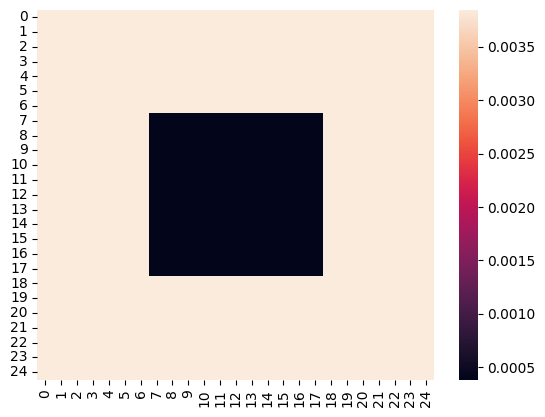

In [139]:
n = 25

ex = np.ones((n, n),np.float32)/260
#ex = np.zeros((n,n))
'''
ex[n-1, :] = 1
ex[0, :] = 1
ex[:, n-1] = 1
ex[:, 0] = 1
par = 1
ex[-par:-1, :] = 1
ex[0:par, :] = 1
ex[:, -par:-1] = 1
ex[:, 0:par] = 1
'''
for i in range(n):
    for j in range(n):
        if (i > 6) & (i < 18):
            if (j > 6) & (j < 18):
                ex[i, j] = 0.1/260
# #print(ex)
# ex = -ex/np.max(ex)/260

# #ex = ex/np.max(ex)/50

import seaborn as sns
sns.heatmap(ex)

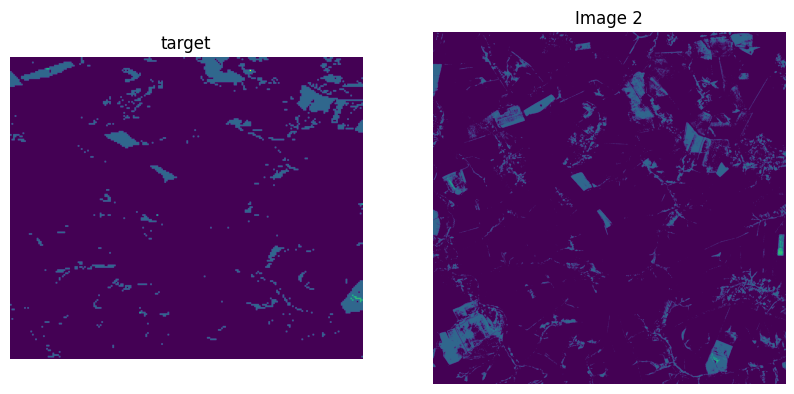

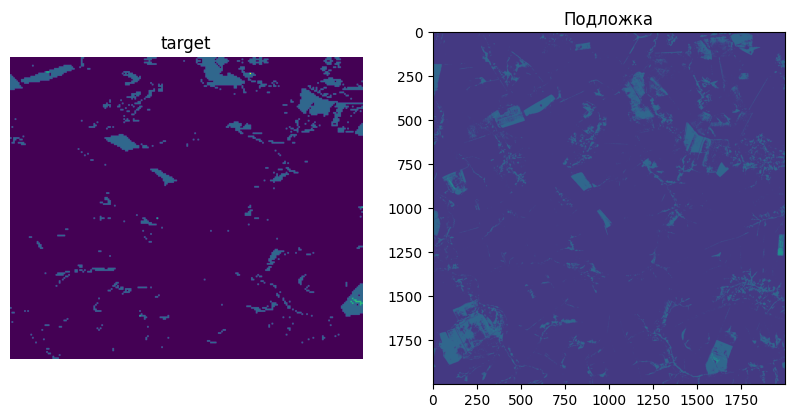

In [172]:

import warnings
warnings.filterwarnings('ignore')

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Покажите первое изображение
img = crop_scenes[1]
#axs[0].imshow(normalized_filtered(crop_scenes[1].img, 'nir, g, b'))
axs[0].imshow(calcus_RVI(img.r, img.nir, True))
axs[0].set_title('target')
axs[0].axis('off')  # Отключите оси, чтобы они не отвлекали

# Покажите второе изображение
bck = Scene(bases[0][0: 2000, 1000: 3000,:],1)
#axs[1].imshow(normalized_filtered(bases[0][0: 2000, 1000: 3000,:], 'nir, g, b'))
axs[1].imshow(calcus_RVI(bck.r, bck.nir, True))
axs[1].set_title('Image 2')
axs[1].axis('off')  # Отключите оси, чтобы они не отвлекали
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Покажите первое изображение
mask_c = false_color_crop_mask(img)
axs[0].imshow(mask_c)
axs[0].set_title('target')
axs[0].axis('off')  # Отключите оси, чтобы они не отвлекали

# Покажите второе изображение
#mask=  false_color_base_mask(bases[0][0: 2000, 1000: 3000,:])
mask=  false_color_base_mask(bck)
#kernel = ex
#sharpened_image = cv2.filter2D(mask , -1, kernel)
#sharpened_image = cv2.filter2D(sharpened_image , -1, kernel)
axs[1].imshow(mask)
axs[1].set_title('Подложка')
#axs[1].axis('off')  # Отключите оси, чтобы они не отвлекали
plt.show()


# RVI

In [179]:
def cut_image_into_parts(image, h, w):
    #scale_factor = 8
    #scaled_image = rescale(image, scale_factor, anti_aliasing=True, multichannel=True)
    

    # Get image dimensions
    img_height, img_width, channels = image.shape
    
    # Calculate the number of parts along each dimension
    num_parts_height = img_height // h
    num_parts_width = img_width // w
    
    parts = []
    j = 0
    for i in range(num_parts_height):
        for j in range(num_parts_width):
            # Calculate the starting and ending coordinates of the part
            start_row = i * h
            end_row = start_row + h
            start_col = j * w
            end_col = start_col + w
            
            # Extract the part
            part = image[start_row:end_row, start_col:end_col, :]
            
            back_scene = Scene(part, 1)
            part = calcus_RVI(back_scene.r, back_scene.nir, True)
            #plt.imsave('C:/Users/Maria Smirnova/Desktop/Проекты/LDT/base_false_color_masks/'  + str(j) + r".png", part, cmap='gray', dpi=300)
            j+=1
            plt.show()
            # Append the part to the list
            parts.append(part)
    
    return parts

In [191]:
#tmp = Scene(bases[0], 1)
tmp = bases[0]
back_imp = calcus_RVI(tmp, tmp, True).astype(np.uint8)
img = crop_scenes[2]
target_image = calcus_RVI(img.r, img.nir, True).astype(np.uint8)
res = cv2.matchTemplate(tmp, target_image, cv2.TM_CCOEFF)
min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
top_left = max_loc
bottom_right = (top_left[0] + w, top_left[1] + h)
 
cv2.rectangle(img,top_left, bottom_right, 255, 2)
 
plt.subplot(121),plt.imshow(res,cmap = 'gray')
plt.title('Matching Result'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(img,cmap = 'gray')
plt.title('Detected Point'), plt.xticks([]), plt.yticks([])
#plt.suptitle(meth)


error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\templmatch.cpp:1164: error: (-215:Assertion failed) (depth == CV_8U || depth == CV_32F) && type == _templ.type() && _img.dims() <= 2 in function 'cv::matchTemplate'


In [227]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'calcus_RVI' and 'crop_scenes' are defined elsewhere in your code

# Your code snippet
# tmp = Scene(bases[0], 1)
tmp = bases[0]

# Convert to uint8 if necessary
tmp = tmp[0:4000, 0:4000, :]#.astype(np.uint8)
back_imp = calcus_RVI(tmp[:, :, 0], tmp[:, :, 3], True)#.astype(np.uint8)

img = crop_scenes[2]
target_image = calcus_RVI(img.r, img.nir, True).astype(np.uint8)
    
# Print properties of the images to debug
print(f"back_imp shape: {back_imp.shape}, dtype: {back_imp.dtype}")
print(f"target_image shape: {target_image.shape}, dtype: {target_image.dtype}")

res = cv2.matchTemplate(back_imp, target_image, cv2.TM_CCOEFF)
min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
top_left = max_loc
h, w = target_image.shape[:2]  # Height and width of the template
bottom_right = (top_left[0] + w, top_left[1] + h)

cv2.rectangle(back_imp, top_left, bottom_right, 255, 250)

plt.subplot(121)
plt.imshow(res, cmap='gray')
plt.title('Matching Result')
plt.xticks([]), plt.yticks([])
plt.subplot(122)
plt.imshow(tmp[:, :, 0:3].astype(np.uint8)) #, cmap='gray'
plt.title('Detected Point')
plt.xticks([]), plt.yticks([])
# plt.suptitle(meth)

plt.show()


back_imp shape: (4000, 4000), dtype: float64
target_image shape: (214, 247), dtype: uint8


error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\templmatch.cpp:1164: error: (-215:Assertion failed) (depth == CV_8U || depth == CV_32F) && type == _templ.type() && _img.dims() <= 2 in function 'cv::matchTemplate'


In [224]:
print(min_val, max_val, min_loc, max_loc)

-2868.978759765625 3232.7216796875 (1354, 3207) (897, 1578)


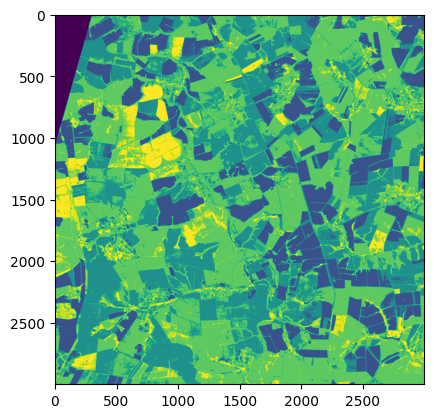

In [204]:
plt.imshow(calcus_RVI(tmp[0:3000, 0:3000, 0], tmp[0:3000, 0:3000, 3], True).astype(np.uint8))

In [ ]:
import cv2
import numpy as np

# Загрузите искаженную и нормальную версии картинки
warped_image = target_image
original_image = cv2.imread('original_image.jpg')

# Преобразуйте изображения в градации серого
warped_gray = cv2.cvtColor(warped_image, cv2.COLOR_BGR2GRAY)
original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)

# Найдите контуры на обоих изображениях
warped_canny = cv2.Canny(warped_gray, 50, 150)
original_canny = cv2.Canny(original_gray, 50, 150)

# Найдите ключевые точки на контурах
warped_keypoints = cv2.goodFeaturesToTrack(warped_canny, 100, 0.01, 10)
original_keypoints = cv2.goodFeaturesToTrack(original_canny, 100, 0.01, 10)

# Найдите соответствие между ключевыми точками
matched_keypoints = []
for warped_kp in warped_keypoints:
    best_match = -1
    min_dist = float('inf')
    for i, original_kp in enumerate(original_keypoints):
        dist = np.linalg.norm(warped_kp[0] - original_kp[0])
        if dist < min_dist:
            min_dist = dist
            best_match = i
    matched_keypoints.append((warped_kp, original_keypoints[best_match]))

# Выровняйте искаженную версию относительно нормальной
H, mask = cv2.findHomography(np.array(matched_keypoints), None, cv2.RANSAC, 5.0)
warped_image_aligned = cv2.warpPerspective(warped_image, H, (original_image.shape[1], original_image.shape[0]))

# Сохраните результат
cv2.imwrite('warped_image_aligned.jpg', warped_image_aligned)

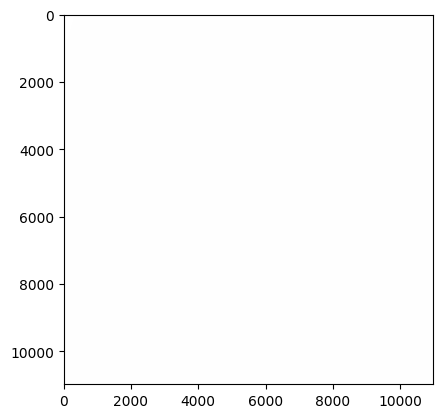

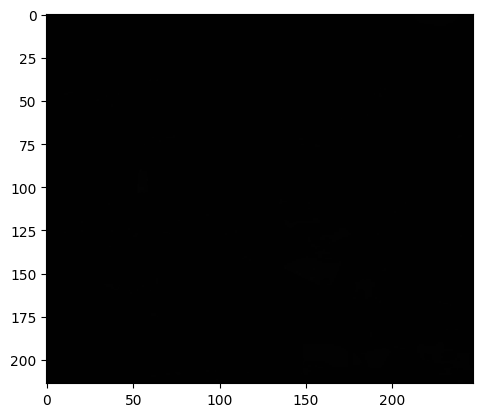

In [197]:
plt.imshow(back_imp)
plt.show()
plt.imshow(target_image)
plt.show()
#plt.imshow(4)